# DCGAN (Deep Convolutional Generative Adversarial Networks)

![DCGAN gif](https://media.giphy.com/media/TL0HO5ikb99YMbF0uv/giphy.gif)

## Introduction

&nbsp;&nbsp;&nbsp;I decided to make this notebook as a kind of summary to the methods that I applied in the [Generative Dog Images](https://www.kaggle.com/c/generative-dog-images) competiton as this was my first introduction to the thrilling world of <b>GANs</b>. I hope that this can be of some use to the reader in terms of training, optimizing and creating a robust <b>GAN</b> that can generalize well to new data. I will also try to provide more detailed explanations on the theory behind <b>GANs</b> and why they are so effective.

&nbsp;&nbsp;&nbsp;The main tools for this exercise will be <b>Tensorflow</b>(eager) and <b>Keras</b>(mainly for custom NN layers).

## Generative Adversarial Networks (GANs)

&nbsp;&nbsp;&nbsp;Unlike most popular neural network architectures, <b>GANs</b> are trained to solve two problems simultaneously - <b>discrimination</b> (effectively separating real from fake images) and <b>"realistic"       fake data generation</b> (effectively generating samples considered as real). As we can see these tasks are complete polar opposites but what would happen if we separated them into different models?

&nbsp;&nbsp;&nbsp;Well the general names for these models are <b>Generator (G)</b> and <b>Discriminator (D)</b> and are considered the building blocks behind the theory of <b>GANs</b>.

&nbsp;&nbsp;&nbsp;The <b>Generator</b> network takes as input a simple random noise N-dimensional vector and transforms it according to a learned target distribution. Its output is also N-dimensional. The <b>Discriminator</b> on the other hand models a probability distribution function (like a classifier) and outputs a probability that the input image is real or fake <b>[0, 1]</b>. With this in mind, we can define the two main goals of the generation task:

<b>1. Train G to maximise D's final classification error.</b> (So that the generated images are perceived as real).

<b>2. Train D to minimise the final classification error.</b> (So that real data is correctly distinguished from fake data).

&nbsp;&nbsp;&nbsp;To achieve this, during <b>backpropagation</b>, <b>G</b>'s weights will be updated using <b>Gradient Ascent</b> to maximise the error, while <b>D</b> will use <b>Gradient Descent</b> to minimise it.

![General structure of GANs](https://miro.medium.com/max/1132/1*t82vgL9KcDVpT4JqCb9Q4Q.png)

&nbsp;&nbsp;&nbsp;Note that the two networks don't use the true distribution of images directly during training but instead use each other's outputs to estimate their performance.

&nbsp;&nbsp;&nbsp;So how do we define a <b>loss function</b> that estimates the cumulative performance of the two networks? Well, we can use the <b>Absolute Error</b> to estimate <b>D</b>'s error and then we can reuse the same function for <b>G</b> but maximised:

$$ E(G,D) =  \frac{1}{2}\;(E_{x\subset{p_{t}}\;}[1 - D(x)] + E_{x\subset{p_{g}}\;}[D(x)]) $$
$$ E = \underset{G}{max} (\underset{D}{min}\;E(G,D)) $$

&nbsp;&nbsp;&nbsp;In this case, <b>$p_{t}$</b> represents the true distribution of images, while <b>$p_{g}$</b> is the distribution created from <b>G</b>.

&nbsp;&nbsp;&nbsp;We can observe that this theory is based on some key concepts of <b>Reinforcement Learning</b>. It can thought of as a two-player minimax game, where the two players are competing against each other and thus progressively improving in their respective tasks.

&nbsp;&nbsp;&nbsp;We saw the basic idea behind the theory of <b>GANs</b>. Now let's take one step further and learn how <b>DCGANs</b> work by applying ideas and methods from <b>Convolutional Neural Networks</b>.

## Deep Convolutional Generative Adversarial Networks (DCGANs)

&nbsp;&nbsp;&nbsp;<b>DCGANs</b> utilize some of the basic principles of <b>CNNs</b> and have thus become one of the most widely used architectures in practice, due to their fast convergence and also due to the fact that they can be very easily adapted into more complex variants (using labels as conditions, applying residual blocks and so on). Here are some of the more important problems that <b>DCGANs</b> solve:

- <b>D is created so that it basically solves a supervised image classification task.</b> (for this case dog or no dog)
- <b>The filters learned by the GAN can be utilized to draw specific objects in the generated image.</b>
- <b>G contains vectorized properties that can learn very complex semantic representations of objects.</b>

&nbsp;&nbsp;&nbsp;Here are some of the core guidelines to consider when creating a stable <b>DCGAN</b>, as opposed to a standard <b>CNN</b>(taken from the official [paper](https://arxiv.org/pdf/1511.06434.pdf)):

- <b>Replace Pooling functions with Strided convolutions.</b> (this allows <b>D</b> to learn its own spatial downsampling and <b>G</b> its respective upsampling without adding any bias to the model)
- <b>Use BatchNorm</b> (it stabilizes learning by normalizing the input to each unit to have zero mean and unit variance, this also helps to create more robust deep models without having the gradients diverging)
- <b>Avoid using Fully-Connected hidden layers (not output).</b> (example for this is global average pooling which seems to hurt convergence speed)
- <b>For G - use ReLU activations and Tanh for the output.</b> (tanh is generally the more preffered activation when you have an image as an output as it has a range of [-1, 1])
- <b>For D - use LeakyReLU activations (and a sigmoid function for the output probabilites).</b> (this is tested empirically and seems to work well for modelling to a higher resolution)

&nbsp;&nbsp;&nbsp;Here is the most standard structure of a <b>DCGAN generator</b>:
![DCGAN generator](https://miro.medium.com/max/875/1*KvMnRfb76DponICrHIbSdg.png)

&nbsp;&nbsp;&nbsp;As we can observe, its initial input is simply a <b>(1, 100)</b> noise vector, which passes through <b>4 Convolutional</b> layers with upsampling and a stride of <b>2</b> to produce a result RGB image of size (64, 64, 3). To achieve this, the input vector is projected onto a 1024-dimensional output to match the input of the first <b>Conv</b> layer, which we will see more later on.

&nbsp;&nbsp;&nbsp;What would a standard discriminator look like? Well, about what you would expect, let's take a look:

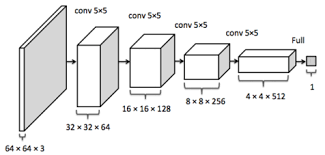

&nbsp;&nbsp;&nbsp;This time around we have an input image of <b>(64, 64, 3)</b>, same as <b>G</b>'s output. We pass it to <b>4 standard downsampling Conv layers</b>, again with a stride of <b>2</b>. In the final output layer, the image gets flattened to a vector, which is usually fed to a sigmoid function, which then outputs <b>D</b>'s prediction for that image <b>(a single value representing the probability in the range [0,1] - dog = 1 or no dog = 0)</b>.

&nbsp;&nbsp;&nbsp;Well, now you saw the basic idea behind <b>GANs</b> and <b>DCGANs</b>, so now we can proceed to generate some dogs :).

&nbsp;&nbsp;&nbsp;Let's first import some libraries and enable <b>Tensorflow's eager execution</b> by removing the computation graphs to speed up the computations.

## Importing libraries

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt, zipfile
import os
import glob
import math
import random
import time
import datetime
import shutil
import imageio
from tqdm import tqdm, tqdm_notebook

from dataclasses import dataclass
from pathlib import Path
import warnings
from scipy import linalg

import xml.etree.ElementTree as ET 

import cv2
from PIL import Image

import tensorflow as tf
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Reshape,\
Conv2DTranspose, Conv2D, Flatten, Dropout, Embedding, ReLU
from tensorflow.keras.optimizers import Adam
from tensorflow.contrib.eager.python import tfe

#from IPython import display

# libraries for SpectralNorm
from tensorflow.keras import backend as K
from keras.engine import *
from keras.legacy import interfaces
from tensorflow.keras import activations
from tensorflow.keras import initializers
from tensorflow.keras import regularizers
from tensorflow.keras import constraints
from keras.utils.generic_utils import func_dump
from keras.utils.generic_utils import func_load
from keras.utils.generic_utils import deserialize_keras_object
from keras.utils.generic_utils import has_arg
from keras.utils import conv_utils

print(os.listdir("./input"))

/home/mattmann/install/python37/lib/python3.7/site-packages/pandas/compat/__init__.py:117: UserWarning: Could not import the lzma module. Your installed Python is incomplete. Attempting to use lzma compression will result in a RuntimeError.
  warnings.warn(msg)
/home/mattmann/install/python37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/mattmann/install/python37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/mattmann/install/python37/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: Future

['all-dogs', 'Annotation']


Using TensorFlow backend.


In [2]:
#from keras.backend.tensorflow_backend import set_session
config = tf.ConfigProto()
config.gpu_options.allow_growth = True  # dynamically grow the memory used on the GPU
#config.log_device_placement = True  # to log device placement (on which device the operation ran)
tf.enable_eager_execution(config=config)

Let's also set some input paths and default variables for later.

## Setting input variables

In [3]:
image_width = 64
image_height = 64
image_channels = 3
image_sample_size = 10000
image_output_dir = './output_images/'
image_input_dir = './input/all-dogs/'
image_ann_dir = "./input/Annotation/"
OUT_DIR = Path('./output_images/')
MODEL_PATH = './dog-face-generation-competition-kid-metric-input/classify_image_graph_def.pb'
TRAIN_DIR = Path('./input/all-dogs')

## Image preprocessing and EDA

&nbsp;&nbsp;&nbsp;Before we proceed with creating the <b>GAN</b> model let's first do a quick exploration of the <b>Stanford Dogs</b> dataset, which we'll be using. Because we also have the annotations for each image, we can use them to map each dog image to its respective breed. To do that, we can first make a dictionary that maps the breed code in the file name to the actual breed name.

### Creating the image features

In [4]:
dog_breed_dict = {}
for annotation in os.listdir(image_ann_dir):
    annotations = annotation.split('-')
    dog_breed_dict[annotations[0]] = annotations[1]

Here I'm going to use <b>OpenCV</b> for a quick function to read and transform the images to <b>RGB</b>.

In [5]:
def read_image(src):
    img = cv2.imread(src)
    if img is None:
        raise FileNotFoundError
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

### Crop the images and apply scaling

&nbsp;&nbsp;&nbsp;If we look at the dataset, we can see that each annotation folder contains a list of <b>xml</b> files. These files are associated with a specific image and contain very useful information, mainly the bounding boxes around each dog in the image. There are also images with more than one dog in them and this allows us to accurately crop them and make a dataset that contains <b>single dogs only</b> images.

&nbsp;&nbsp;&nbsp;Here we can utilize the <b>xml</b> library to create a tree and find the relevant elements for that annotation. For each object we can extract the bounding box coordinates, crop the images and normalize the crop by <b>shrinking</b> or <b>expanding</b> it depending on the result <b>image width</b>. Finally, we'll save the images in a numpy array.

In [6]:
def load_cropped_images(dog_breed_dict=dog_breed_dict, image_ann_dir=image_ann_dir, sample_size=25000, 
                        image_width=image_width, image_height=image_height, image_channels=image_channels):
    curIdx = 0
    breeds = []
    dog_images_np = np.zeros((sample_size,image_width,image_height,image_channels))
    for breed_folder in os.listdir(image_ann_dir):
        for dog_ann in tqdm(os.listdir(image_ann_dir + breed_folder)):
            try:
                img = read_image(os.path.join(image_input_dir, dog_ann + '.jpg'))
            except FileNotFoundError:
                continue
                
            tree = ET.parse(os.path.join(image_ann_dir + breed_folder, dog_ann))
            root = tree.getroot()
            
            size = root.find('size')
            width = int(size.find('width').text)
            height = int(size.find('height').text)
            objects = root.findall('object')
            for o in objects:
                bndbox = o.find('bndbox') 
                
                xmin = int(bndbox.find('xmin').text)
                ymin = int(bndbox.find('ymin').text)
                xmax = int(bndbox.find('xmax').text)
                ymax = int(bndbox.find('ymax').text)
                
                xmin = max(0, xmin - 4)        # 4 : margin
                xmax = min(width, xmax + 4)
                ymin = max(0, ymin - 4)
                ymax = min(height, ymax + 4)

                w = np.min((xmax - xmin, ymax - ymin))
                w = min(w, width, height)                     # available w

                if w > xmax - xmin:
                    xmin = min(max(0, xmin - int((w - (xmax - xmin))/2)), width - w)
                    xmax = xmin + w
                if w > ymax - ymin:
                    ymin = min(max(0, ymin - int((w - (ymax - ymin))/2)), height - w)
                    ymax = ymin + w
                
                img_cropped = img[ymin:ymin+w, xmin:xmin+w, :]      # [h,w,c]
                # Interpolation method
                if xmax - xmin > image_width:
                    interpolation = cv2.INTER_AREA          # shrink
                else:
                    interpolation = cv2.INTER_CUBIC         # expansion
                    
                img_cropped = cv2.resize(img_cropped, (image_width, image_height), 
                                         interpolation=interpolation)  # resize
                    
                dog_images_np[curIdx,:,:,:] = np.asarray(img_cropped)
                dog_breed_name = dog_breed_dict[dog_ann.split('_')[0]]
                breeds.append(dog_breed_name)
                curIdx += 1
                
    return dog_images_np, breeds

*The features take about 2-3 mins to load. *

&nbsp;&nbsp;&nbsp;By trial, we can figure out that the result images with single dogs only are <b>22125</b> and thus we can specify the exact size of our numpy array. There are <b>120</b> different dog breeds.

In [7]:
start_time = time.time()
dog_images_np, breeds = load_cropped_images(sample_size=22125)
est_time = round(time.time() - start_time)
print("Feature loading time: {}.".format(str(datetime.timedelta(seconds=est_time))))

100%|██████████| 169/169 [00:00<00:00, 414.47it/s]

Feature loading time: 0:00:50.


In [8]:
print('Loaded features shape: ', dog_images_np.shape)
print('Loaded labels: ', len(breeds))

Loaded features shape:  (22125, 64, 64, 3)
Loaded labels:  22125


&nbsp;&nbsp;&nbsp;Now that we have the features and labels, we can plot them in a square grid to see what the crops look like and to make sure that they are labeled correctly.

In [9]:
def plot_features(features, labels, image_width=image_width, image_height=image_height, 
                image_channels=image_channels,
                examples=25, disp_labels=True): 
  
    if not math.sqrt(examples).is_integer():
        print('Please select a valid number of examples.')
        return
    
    imgs = []
    classes = []
    for i in range(examples):
        rnd_idx = np.random.randint(0, len(labels))
        imgs.append(features[rnd_idx, :, :, :])
        classes.append(labels[rnd_idx])
    
    
    fig, axes = plt.subplots(round(math.sqrt(examples)), round(math.sqrt(examples)),figsize=(15,15),
    subplot_kw = {'xticks':[], 'yticks':[]},
    gridspec_kw = dict(hspace=0.3, wspace=0.01))
    
    for i, ax in enumerate(axes.flat):
        if disp_labels == True:
            ax.title.set_text(classes[i])
        ax.imshow(imgs[i])

Note that we need to normalize the pixel values to make sure that the dogs are plotted correctly.

Plotting cropped images by their specified coordinates..


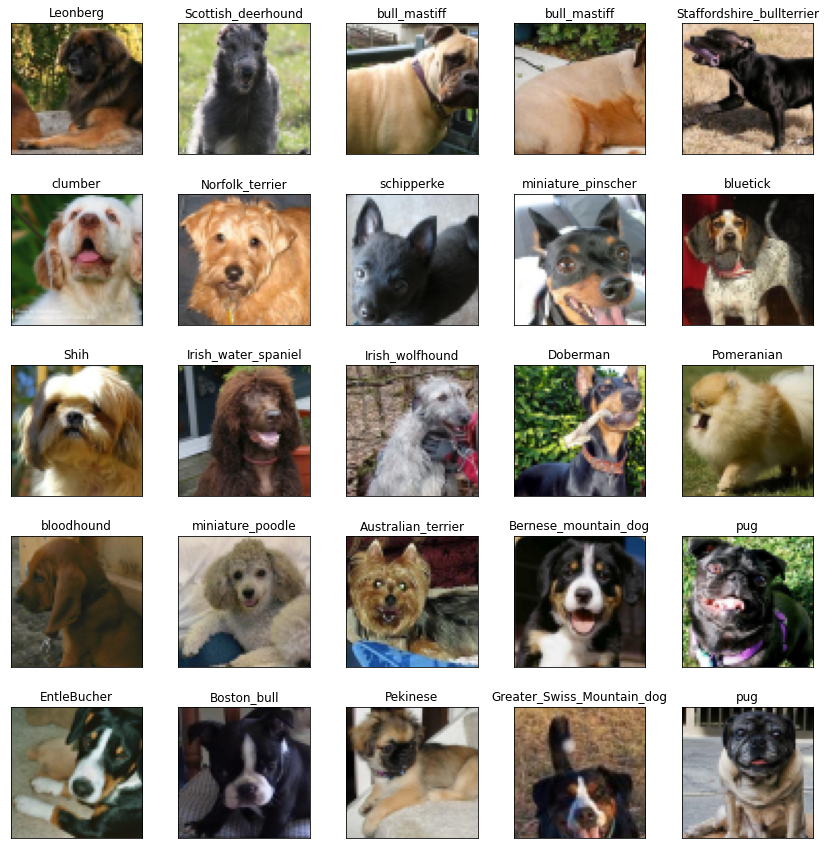

In [10]:
print('Plotting cropped images by their specified coordinates..')
plot_features(dog_images_np / 255., breeds, examples=25, disp_labels=True)

The crops definitely are not perfect, but they do seem to capture only one dog in each image.

### Normalize the pixel values of the images

&nbsp;&nbsp;&nbsp;If you recall from the <b>DCGAN</b> guideline, the <b>Generator</b> is suggested to have a <b>Tanh</b> activation function for its output layer. This means that it produces values in the range <b>[-1, 1]</b> meaning that we also have to apply the same range to our features as a preprocessing step.

In [11]:
dog_images_np = (dog_images_np - 127.5) / 127.5  # normalize the pixel range to [-1, 1] ((image - 127.5) / 127.5) or [0, 1] (image / 255.) alternatively

This is what the images would look like in the input layer of <b>D</b>.

Plotting cropped images by their specified coordinates..


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

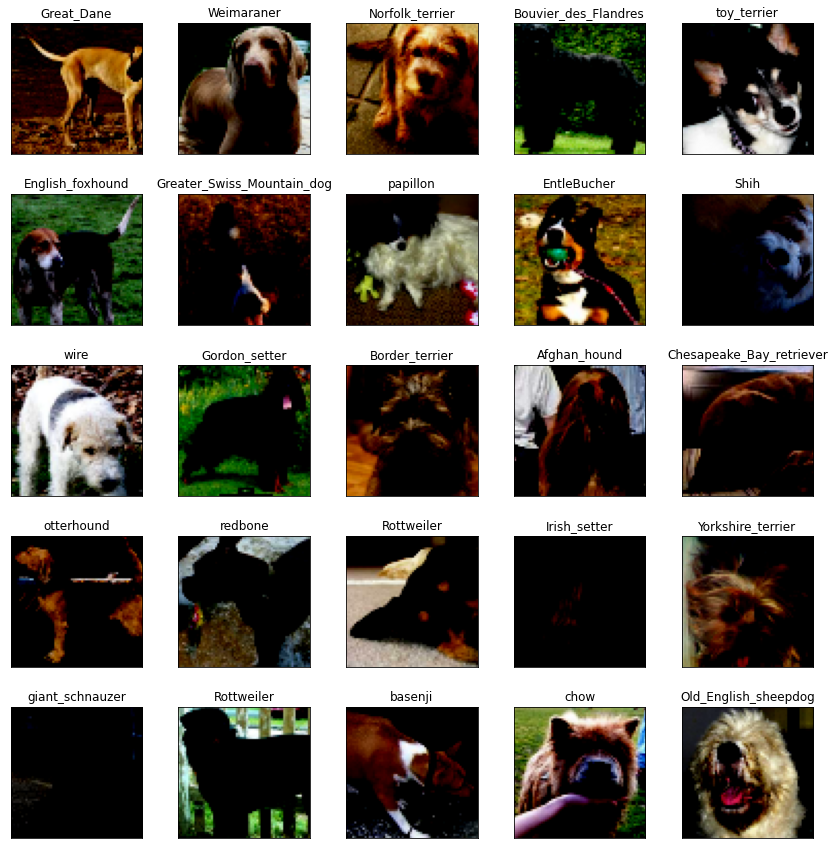

In [12]:
print('Plotting cropped images by their specified coordinates..')
plot_features(dog_images_np, breeds, examples=25, disp_labels=True)

If we select a random image and print out the <b>max and min</b> we can see that the values are correct.

In [13]:
print(np.max(dog_images_np[3,:,:,:]), np.min(dog_images_np[3,:,:,:]))

1.0 -0.9686274509803922


### Deprocessing back to the original values

What if we want to return them back to normal? Easy, we just apply the reverse operations and plot them again.

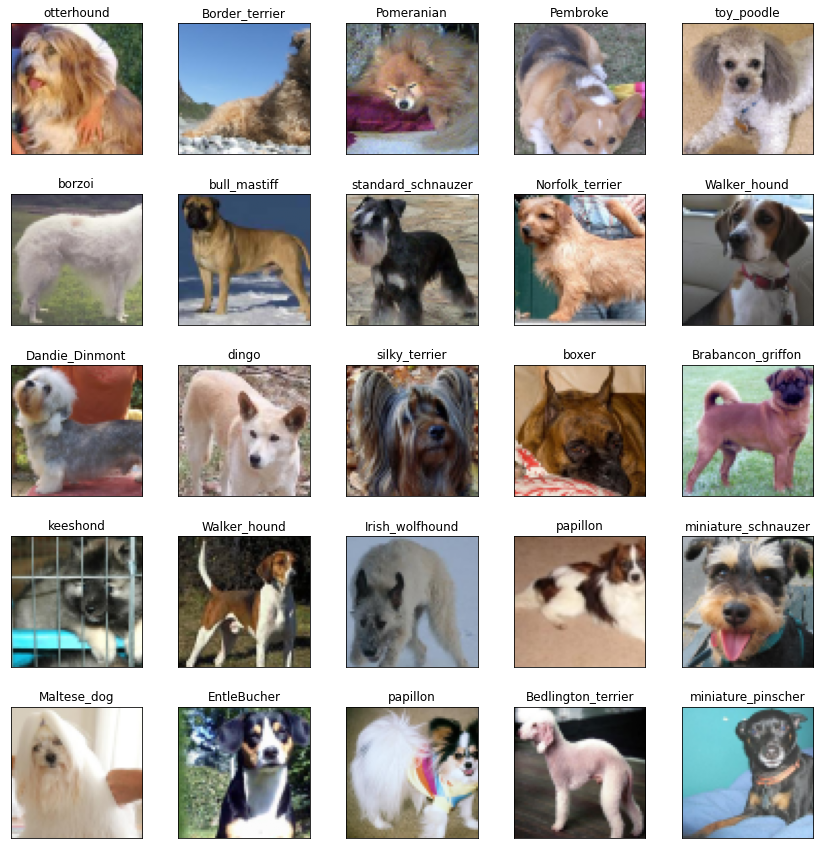

In [14]:
plot_features((dog_images_np * 127.5 + 127.5) / 255., breeds, examples=25, disp_labels=True)

## Creating the image dataset

&nbsp;&nbsp;&nbsp;Now let's use our numpy array of features to construct a <b>Tensorflow</b> dataset object. First, we can convert the data types to <b>float32</b>, which always helps to preserve some memory.

In [15]:
print("Dog features shape:", dog_images_np.shape)

Dog features shape: (22125, 64, 64, 3)


In [16]:
dog_features_tf = tf.cast(dog_images_np, 'float32')

### Data Augmentation

&nbsp;&nbsp;&nbsp;We could also apply <b>Data Augmentation</b> to our dataset. This includes random <b>horizontal flips</b>, zooming and cropping the image in random regions. Out of these, I found only the first method to be somewhat useful for adding some more variance to the dataset, as the other methods introduce a lot of noise.

&nbsp;&nbsp;&nbsp;So in this case, there will be a <b>50%</b> chance that an image in our dataset will be flipped from left to right.

In [17]:
def flip(x: tf.Tensor) -> (tf.Tensor):
    x = tf.image.random_flip_left_right(x)
    return x

def zoom(x: tf.Tensor) -> (tf.Tensor):
    # Generate 20 crop settings, ranging from a 1% to 20% crop.
    scales = list(np.arange(0.7, 1.0, 0.01))
    boxes = np.zeros((len(scales), 4))

    for i, scale in enumerate(scales):
        x1 = y1 = 0.5 - (0.5 * scale)
        x2 = y2 = 0.5 + (0.5 * scale)
        boxes[i] = [x1, y1, x2, y2]

    def random_crop(img):
        # Create different crops for an image
        crops = tf.image.crop_and_resize([img], boxes=boxes, box_ind=np.zeros(len(scales)), crop_size=(64, 64))
        # Return a random crop
        return crops[tf.random_uniform(shape=[], minval=0, maxval=len(scales), dtype=tf.int32)]


    choice = tf.random_uniform(shape=[], minval=0., maxval=1., dtype=tf.float32)

    # Only apply cropping 50% of the time
    return (tf.cond(choice < 0.5, lambda: x, lambda: random_crop(x)))

### Set model hyperparameters

&nbsp;&nbsp;&nbsp;Here we have a whole list of hyperparameters that you can tune and play around with to try and improve the model. I've mostly gathered these values from research papers and experimented a bit with tweaking them and this is what I ended up with. Here's a list of things you could try out:

- <b>Sample size</b> - the number of features
- <b>Batch size</b> - 64 or 32 could improve performance, but are computationally heavy and you can only run the model for a small amount of epochs
- <b>Weight Init Std and Mean</b> - these values are come from research papers and seem to stabilize model training
- <b>Leaky ReLU slope</b> - the threshold for <b>D</b>'s activations, also seems robust
- <b>Downsize factor and Scale factor</b> - set up so that <b>G</b>'s noise vector can be reshaped to (4, 4, 512), other combinations might also work
- <b>Dropout</b> - amount of dropout layers, their placement and their rate could improve performance.
- <b>Learning rate and Learning rate decay</b> - very important to model convergence, hard to tune precisely, <b>G</b> and <b>D</b> can have different learning rates.
- <b>Noise vector shape</b> - usually 128 or 100 seems to be sufficient

In [18]:
sample_size = 22125
batch_size = 128
weight_init_std = 0.02
weight_init_mean = 0.0
leaky_relu_slope = 0.2
downsize_factor = 2
dropout_rate = 0.5
scale_factor = 4 ** downsize_factor
lr_initial_d = tfe.Variable(0.0002)
lr_initial_g = tfe.Variable(0.0002)
lr_decay_steps = 1000
noise_dim = 128

### Create tensorflow-type dataset

&nbsp;&nbsp;&nbsp;Now we can use <b>Tensorflow</b> to create the dataset by shuffling it, applying some augmentation, and finally separating it into batches of the specified <b>Batch size</b>.

In [19]:
dog_features_data = tf.data.Dataset.from_tensor_slices(dog_features_tf).shuffle(sample_size).map(flip).batch(batch_size, drop_remainder=True)

In [20]:
print(dog_features_data)

<DatasetV1Adapter shapes: (128, 64, 64, 3), types: tf.float32>


## Normalization techniques

### Weight Initialization

&nbsp;&nbsp;&nbsp;Before we actually make the <b>Generator</b>, let's see a few normalizations that can gradually speed up a <b>DCGAN</b>'s convergence. 

&nbsp;&nbsp;&nbsp;One of these methods is <b>Weight initialization</b>. It turns out that it's pretty important for training stable <b>GANs</b>. Firstly, the model weights need to be <b>zero-centered</b> with a slight increase of <b>std</b>(0.02). This stabilizes both <b>D</b> and <b>G</b> during training and prevents the model gradients from vanishing or exploding. This is a key step in every case, where we have to use random variables in our model (the random noise vector). 

&nbsp;&nbsp;&nbsp;Here is an example of how <b>Weight initialization</b> can seriously affect the learning process of a Neural Network.

![Weight Initialization example](https://intoli.com/blog/neural-network-initialization/img/training-losses.png)

&nbsp;&nbsp;&nbsp;We can also apply a <b>Truncated Normal</b> distribution using <b>Keras</b>, which will discard <b>values more than 2 standard deviations from the mean</b>. This could perhaps eliminate some outlier points during training.

In [21]:
weight_initializer = tf.keras.initializers.TruncatedNormal(stddev=weight_init_std, mean=weight_init_mean,
                                                          seed=42)

### Spectral Normalization

&nbsp;&nbsp;&nbsp;<b>Spectral Normalization</b> is a new type of weight initialization, designed specifically for <b>GANs</b>, which seems to further stabilize model training (you can read more from this [paper](https://arxiv.org/pdf/1802.05957.pdf)). For a more detailed explanation on <b>Spectral Normalization</b> and why it works it also worth to check out this [post](https://christiancosgrove.com/blog/2018/01/04/spectral-normalization-explained.html), it has very intuitive examples.

&nbsp;&nbsp;&nbsp;<b>Spectral Normalization</b> of a single weight in our network can be defined as the following:

$$ \sigma(W) = ||Wv|| = u^{T}Wv $$
$$ W_{SN}(W) = \frac{W}{\sigma(W)} $$

&nbsp;&nbsp;&nbsp;Here $u$ and $v$ are simple random vectors of the same size. They are utilized to perform what's called a <b>power iteration</b> operation on the specific weight, for each learning step and it proves to be a lot more computationally efficient than simply penalizing the gradients.

&nbsp;&nbsp;&nbsp;Afterwards, in the backpropagation step, we use $W_{SN}(W)$ to update the weights instead of $W$.

&nbsp;&nbsp;&nbsp;For this project, I will reuse some custom <b>Keras</b> layers implemented by <b>IShengFang</b> ([official code](https://github.com/IShengFang/SpectralNormalizationKeras)), to apply <b>Spectral Normalization</b> on top of <b>Conv</b> and <b>Dense</b> layers.

&nbsp;&nbsp;&nbsp;Here is also a good example on the effect of <b>Spectral Normalization</b>:

<center><b>With SN</b></center>
![SNGAN](https://raw.githubusercontent.com/IShengFang/SpectralNormalizationKeras/master/img/generated_img_CIFAR10_resnet_SN_GP/loss.png)

<center><b>Without SN</b></center>
![StandardGAN](https://raw.githubusercontent.com/IShengFang/SpectralNormalizationKeras/master/img/generated_img_CIFAR10_resnet_noSN_GP/loss.png)

In [22]:
class DenseSN(Dense):
    def build(self, input_shape):
        assert len(input_shape) >= 2
        input_dim = input_shape[-1]
        self.kernel = self.add_weight(shape=(input_dim, self.units),
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.units,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                                 initializer=initializers.RandomNormal(0, 1),
                                 name='sn',
                                 trainable=False)
        self.input_spec = InputSpec(min_ndim=2, axes={-1: input_dim})
        self.built = True
        
    def call(self, inputs, training=None):
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                 W_bar = K.reshape(W_bar, W_shape)  
        output = K.dot(inputs, W_bar)
        if self.use_bias:
            output = K.bias_add(output, self.bias, data_format='channels_last')
        if self.activation is not None:
            output = self.activation(output)
        return output 
    
class ConvSN2D(Conv2D):

    def build(self, input_shape):
        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1
        if input_shape[channel_axis] is None:
            raise ValueError('The channel dimension of the inputs '
                             'should be defined. Found `None`.')
        input_dim = input_shape[channel_axis]
        kernel_shape = self.kernel_size + (input_dim, self.filters)

        self.kernel = self.add_weight(shape=kernel_shape,
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)

        if self.use_bias:
            self.bias = self.add_weight(shape=(self.filters,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
            
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                         initializer=initializers.RandomNormal(0, 1),
                         name='sn',
                         trainable=False)
        
        # Set input spec.
        self.input_spec = InputSpec(ndim=self.rank + 2,
                                    axes={channel_axis: input_dim})
        self.built = True
    def call(self, inputs, training=None):
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            #Accroding the paper, we only need to do power iteration one time.
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        #Spectral Normalization
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                W_bar = K.reshape(W_bar, W_shape)
                
        outputs = K.conv2d(
                inputs,
                W_bar,
                strides=self.strides,
                padding=self.padding,
                data_format=self.data_format,
                dilation_rate=self.dilation_rate)
        if self.use_bias:
            outputs = K.bias_add(
                outputs,
                self.bias,
                data_format=self.data_format)
        if self.activation is not None:
            return self.activation(outputs)
        return outputs

class ConvSN2DTranspose(Conv2DTranspose):

    def build(self, input_shape):
        if len(input_shape) != 4:
            raise ValueError('Inputs should have rank ' +
                             str(4) +
                             '; Received input shape:', str(input_shape))
        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1
        if input_shape[channel_axis] is None:
            raise ValueError('The channel dimension of the inputs '
                             'should be defined. Found `None`.')
        input_dim = input_shape[channel_axis]
        kernel_shape = self.kernel_size + (self.filters, input_dim)

        self.kernel = self.add_weight(shape=kernel_shape,
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.filters,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
            
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                         initializer=initializers.RandomNormal(0, 1),
                         name='sn',
                         trainable=False)
        
        # Set input spec.
        self.input_spec = InputSpec(ndim=4, axes={channel_axis: input_dim})
        self.built = True  
    
    def call(self, inputs):
        input_shape = K.shape(inputs)
        batch_size = input_shape[0]
        if self.data_format == 'channels_first':
            h_axis, w_axis = 2, 3
        else:
            h_axis, w_axis = 1, 2

        height, width = input_shape[h_axis], input_shape[w_axis]
        kernel_h, kernel_w = self.kernel_size
        stride_h, stride_w = self.strides
        if self.output_padding is None:
            out_pad_h = out_pad_w = None
        else:
            out_pad_h, out_pad_w = self.output_padding

        # Infer the dynamic output shape:
        out_height = conv_utils.deconv_length(height,
                                              stride_h, kernel_h,
                                              self.padding,
                                              out_pad_h)
        out_width = conv_utils.deconv_length(width,
                                             stride_w, kernel_w,
                                             self.padding,
                                             out_pad_w)
        if self.data_format == 'channels_first':
            output_shape = (batch_size, self.filters, out_height, out_width)
        else:
            output_shape = (batch_size, out_height, out_width, self.filters)
            
        #Spectral Normalization    
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            #Accroding the paper, we only need to do power iteration one time.
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                W_bar = K.reshape(W_bar, W_shape)
        self.kernel = W_bar
        
        outputs = K.conv2d_transpose(
            inputs,
            self.kernel,
            output_shape,
            self.strides,
            padding=self.padding,
            data_format=self.data_format)

        if self.use_bias:
            outputs = K.bias_add(
                outputs,
                self.bias,
                data_format=self.data_format)

        if self.activation is not None:
            return self.activation(outputs)
        return outputs

&nbsp;&nbsp;&nbsp;Let's also define some template layers in <b>Keras</b>, so that we can create <b>G</b> and <b>D</b> more easily later on. The standard pattern for the layers will be:

<center><b>TP_Conv_Block = [(Conv(SN)2DTranspose (upsample)) -> (BatchNorm) -> (ReLU)]</b></center>

<center><b>Conv_Block = [(Conv(SN)2D (downsample)) -> (BatchNorm) -> (LeakyReLU)]</b></center>

In [23]:
def transposed_conv(model, out_channels, ksize, stride_size, ptype='same'):
    model.add(Conv2DTranspose(out_channels, (ksize, ksize),
                              strides=(stride_size, stride_size), padding=ptype, 
                              kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(ReLU())
    return model

def transposed_convSN(model, out_channels, ksize, stride_size, ptype='same'):
    model.add(ConvSN2DTranspose(out_channels, (ksize, ksize), 
                              strides=(stride_size, stride_size), padding=ptype, 
                              kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(ReLU())
    return model

def convSN(model, out_channels, ksize, stride_size):
    model.add(ConvSN2D(out_channels, (ksize, ksize), strides=(stride_size, stride_size), padding='same',
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_relu_slope))
    #model.add(Dropout(dropout_rate))
    return model

def conv(model, out_channels, ksize, stride_size):
    model.add(Conv2D(out_channels, (ksize, ksize), strides=(stride_size, stride_size), padding='same',
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=leaky_relu_slope))
    #model.add(Dropout(dropout_rate))
    return model

## The Generator

&nbsp;&nbsp;&nbsp;We can finally define our generator. The model structure is mostly based on the official DCGAN [paper](https://arxiv.org/pdf/1511.06434.pdf) with a few tweaks that I found beneficial to the performance. Here is the overall structure:

<center><b>[Input(128, 1) -> Dense(2048,) -> Reshape(4, 4, 128) -> TP_Conv_Block(Depth=512, K=5x5, S=1x1) -> Dropout(0.5) -> TP_Conv_Block(Depth=256, K=5x5, S=2x2) -> Dropout(0.5) -> TP_Conv_Block(Depth=128, K=5x5, S=2x2) -> TP_Conv_Block(Depth=64, K=5x5, S=2x2) -> TP_Conv_Block(Depth=32, K=5x5, S=2x2) -> Dense(Depth=3, Tanh)]</b></center>

In [24]:
def DogGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 128,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 128)))
    
    model = transposed_conv(model, 512, ksize=5, stride_size=1)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)
    model = transposed_conv(model, 32, ksize=5, stride_size=2)
    
    model.add(Dense(3, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [25]:
dog_generator = DogGenerator()
print(dog_generator.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2048)              264192    
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 4, 4, 512)         1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 4, 4, 512)         2048      
_________________________________________________________________
re_lu (ReLU)                 (None, 4, 4, 512)         0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 8, 8, 256)         3

&nbsp;&nbsp;&nbsp;We can confirm that the <b>Generator</b> works initially by feeding it a random noise vector of the right size. The output image should be normalized to similar black-colored pixels due to the <b>Weight Initialization</b> step described earlier <b>(they should be relatively zero-centered)</b>.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 64, 64, 3)
(1, 128) 0.1071524 0.921323


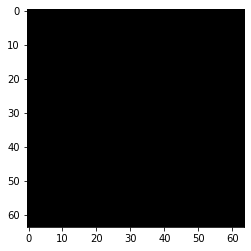

In [26]:
# random noise vector
noise = tf.random.normal([1,noise_dim])
#sample = generate_latent_points(100, 50)
# run the generator model with the noise vector as input
generated_image = dog_generator(noise, training=False)
# display output
plt.imshow(generated_image[0, :, :, :])
print(generated_image.shape)
#print(sample.shape, sample.mean(), sample.std())
print(noise.shape, tf.math.reduce_mean(noise).numpy(), tf.math.reduce_std(noise).numpy())

## The Discriminator

&nbsp;&nbsp;&nbsp;The <b>Discriminator</b> is relatively easier to implement, since its basically a small <b>CNN</b> two-class classifier. We can choose whether to apply <b>Spectral Normalization</b> or not and see the performance effects. For this example, I will try to apply <b>SN</b> only in <b>D</b>. Here is <b>D</b>'s structure:

<center><b>[Input(128, 128, 3) -> Conv(SN)2D(Depth=64, K=5x5, S=1x1, same) -> LeakyReLU -> Conv_Block(Depth=64, K=5x5, S=2x2) -> Conv_Block(Depth=128, K=5x5, S=2x2) -> Conv_Block(Depth=256, K=5x5, S=2x2) -> Flatten -> Dense(16384, Sigmoid)]</b></center>

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;
&nbsp;&nbsp;&nbsp;Also note that all <b>Conv</b> and <b>Dense</b> layers are initialized with the <b>Truncated Normal</b> distribution defined above. Another thing is that the <b>bias</b> term is removed from the <b>Conv</b> layers, which also stabilizes the model a little bit.

In [27]:
def DogDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(ConvSN2D(64, (5, 5), strides=(1,1), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, image_channels], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        #model.add(Dropout(dropout_rate))
        
        model = convSN(model, 64, ksize=5, stride_size=2)
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = convSN(model, 128, ksize=5, stride_size=2)
        #model = convSN(model, 256, ksize=3, stride_size=1)
        model = convSN(model, 256, ksize=5, stride_size=2)
        #model = convSN(model, 512, ksize=3, stride_size=1)
        #model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(DenseSN(1, activation='sigmoid'))
    else:
        model.add(Conv2D(64, (4, 4), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, image_channels], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        #model.add(Dropout(dropout_rate))

        model = conv(model, 64, ksize=4, stride_size=2)
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = conv(model, 128, ksize=4, stride_size=2)
        #model = convSN(model, 256, ksize=3, stride_size=1)
        model = conv(model, 256, ksize=4, stride_size=2)
        #model = convSN(model, 512, ksize=3, stride_size=1)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
    return model

In [28]:
dog_discriminator = DogDiscriminator(spectral_normalization=True)
print(dog_discriminator.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv_s_n2d (ConvSN2D)        (None, 64, 64, 64)        4864      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 64)        0         
_________________________________________________________________
conv_s_n2d_1 (ConvSN2D)      (None, 32, 32, 64)        102464    
_________________________________________________________________
batch_normalization_5 (Batch (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv_s_n2d_2 (ConvSN2D)      (None, 16, 16, 128)       204928    
_________________________________________________________________
batch_normalization_6 (Batch (None, 16, 16, 128)      

Below we can observe, that <b>D</b> indeed outputs a probability very close to <b>0.5</b> for a noisy input.

In [29]:
decision = dog_discriminator(generated_image)
print(decision)

tf.Tensor([[0.50000024]], shape=(1, 1), dtype=float32)


## Further optimization tricks

### Label smoothing

&nbsp;&nbsp;&nbsp;One regularization method that can be applied during training is called <b>Label smoothing</b>. What this does is that it essentially prevents <b>D</b> from being overconfident or underconfident in its predictions. If <b>D</b> becomes too certain that there is a dog in a specific image, <b>G</b> can exploit that fact and continuously start to generate only images of that sort and in turn, cease to improve. We can combat this, by setting the class labels to be in the range <b>[0, 0.3]</b> for the negative classes and <b>[0.7, 1]</b> for the positive ones. 

&nbsp;&nbsp;&nbsp;This will prevent the overall probabilities from getting very close to the two thresholds.

In [30]:
# Label smoothing -- technique from GAN hacks, instead of assigning 1/0 as class labels, we assign a random integer in range [0.7, 1.0] for positive class
# and [0.0, 0.3] for negative class

def smooth_positive_labels(y):
    return y - 0.3 + (np.random.random(y.shape) * 0.5)

def smooth_negative_labels(y):
    return y + np.random.random(y.shape) * 0.3

### Introducing some noise to the labels

&nbsp;&nbsp;&nbsp;This technique is also called <b>Instance Noise</b>. By adding a small amount of error to the labels (let's say 5%), this tends to make the true and predicted distributions more spread out and thus start to overlap with each other. This in turn makes fitting a custom distribution of generated images easier in the learning process.

&nbsp;&nbsp;&nbsp;Here is a good example of how the two distributions look like with these techniques:

![Smoothing and noise effect on distributions](https://www.inference.vc/content/images/2016/10/instance_noise.png)

In [31]:
# randomly flip some labels
def noisy_labels(y, p_flip):
    # determine the number of labels to flip
    n_select = int(p_flip * int(y.shape[0]))
    # choose labels to flip
    flip_ix = np.random.choice([i for i in range(int(y.shape[0]))], size=n_select)
    
    op_list = []
    # invert the labels in place
    #y_np[flip_ix] = 1 - y_np[flip_ix]
    for i in range(int(y.shape[0])):
        if i in flip_ix:
            op_list.append(tf.subtract(1, y[i]))
        else:
            op_list.append(y[i])
    
    outputs = tf.stack(op_list)
    return outputs

### Optimizers

&nbsp;&nbsp;&nbsp;The best proven optimization algorithm for this task is <b>Adam</b> with a standard learning rate of <b>0.0002</b> for both models and a beta of <b>0.5</b>.

In [32]:
generator_optimizer = tf.train.AdamOptimizer(learning_rate=lr_initial_g, beta1=0.5)
discriminator_optimizer = tf.train.AdamOptimizer(learning_rate=lr_initial_d, beta1=0.5)
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

### Defining the loss functions

&nbsp;&nbsp;&nbsp;Another new trend in optimizing <b>GANs</b> recently has been applying a <b>Relativistic</b> loss function as opposed to the standard one. Those functions measure the probability that the real data is more "realistic" than the generated data. One of the more popular relativistic function choices include <b>RaLSGAN (Relativistic Average Least Squares), RaSGAN (Relativistic Average Standard) and RaHinge (Relativistic Hinge loss)</b>.

&nbsp;&nbsp;&nbsp;But before all of that, let's define the standard <b>GAN</b> loss:

$$ \underset{D}{min}(V(D)) = - E_{x}[\log{D(x)}] - E_{z}[\log{(1-D(G(z)))}] $$

&nbsp;&nbsp;&nbsp;As we can observe, this is basically the standard <b>Binary Crossentropy loss</b> used for classification tasks or the <b>Logistic Loss</b> between the real and generated distributions.

&nbsp;&nbsp;&nbsp;In comparison, here is what an <b>RSGAN (Relativistic Standard)</b> loss looks like:

$$ L^{RSGAN}_{D} = - E_{(x_{r},x_{f})}[\log{(sigmoid(C(x_{r}) - C(x_{f})))}] $$
$$ L^{RSGAN}_{G} = - E_{(x_{r},x_{f})}[\log{(sigmoid(C(x_{f}) - C(x_{r})))}] $$

&nbsp;&nbsp;&nbsp;In this case the task is different, to measure the similarity between the <b>real (r)</b> and <b>fake (f)</b> data distributions. RSGAN reaches the optimal point when D(x) = 0.5 (i.e. $C(x_{r}) = C(x_{f})$). There are many relativistic loss function variants and they all contain different methods for measuring this similarity. In this project, I've tried out <b>3</b> of the variants that seemed to have the best documented <b>MIFID</b> score <b>(RaLSGAN, RaSGAN and RaHinge)</b>. Feel free to try out different losses for yourself to see if you can improve the performance ;). Here's a big list of the most commonly used ones:

![GAN losses](https://miro.medium.com/max/875/1*QKG1fVOMjGlVUvICYmz8vQ.png)

&nbsp;&nbsp;&nbsp;With this in mind, I have devised a nice little decision tree function for choosing the losses for both <b>G</b> and <b>D</b>. Note that <b>instance noise</b> and <b>label smoothing</b> need to be applied before calculating the actual losses. 

&nbsp;&nbsp;&nbsp;Throughout many trials for this particular problem, I didn't find any increase in performance by switching to <b>Relativistic</b> losses, so I decided to stick with the standard <b>GAN</b> loss function, as it is much simpler to estimate, though in some cases these losses can really speed up convergence in your model.

In [33]:
def discriminator_loss(real_output, fake_output, loss_func, apply_label_smoothing=True, label_noise=True):
    if label_noise and apply_label_smoothing:
        real_output_noise = noisy_labels(tf.ones_like(real_output), 0.05)
        fake_output_noise = noisy_labels(tf.zeros_like(fake_output), 0.05)
        real_output_smooth = smooth_positive_labels(real_output_noise)
        fake_output_smooth = smooth_negative_labels(fake_output_noise)
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_smooth), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_smooth - tf.reduce_mean(fake_output_smooth) - tf.ones_like(real_output_smooth)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output_smooth) + tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output_smooth)
                D_r_tilde = tf.nn.sigmoid(real_output_smooth - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_smooth) - (real_output_smooth - tf.reduce_mean(fake_output_smooth))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) + (fake_output_smooth - tf.reduce_mean(real_output_smooth))))
        total_loss = real_loss + fake_loss
        return total_loss
    elif label_noise and not apply_label_smoothing:
        real_output_noise = noisy_labels(tf.ones_like(real_output), 0.05)
        fake_output_noise = noisy_labels(tf.zeros_like(fake_output), 0.05)
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_noise), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_noise), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_noise - tf.reduce_mean(fake_output_noise) - tf.ones_like(real_output_noise)))
        + tf.reduce_mean(tf.square(fake_output_noise - tf.reduce_mean(real_output_noise) + tf.ones_like(fake_output_noise)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_noise)
                avg_real_logit = tf.reduce_mean(real_output_noise)
                D_r_tilde = tf.nn.sigmoid(real_output_noise - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_noise - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_noise) - (real_output_noise - tf.reduce_mean(fake_output_noise))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_noise) + (fake_output_noise - tf.reduce_mean(real_output_noise))))
        total_loss = real_loss + fake_loss
        return total_loss
    elif apply_label_smoothing and not label_noise:
        real_output_smooth = smooth_positive_labels(tf.ones_like(real_output))
        fake_output_smooth = smooth_negative_labels(tf.zeros_like(fake_output))
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_smooth), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_smooth - tf.reduce_mean(fake_output_smooth) - tf.ones_like(real_output_smooth)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output_smooth) + tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output_smooth)
                D_r_tilde = tf.nn.sigmoid(real_output_smooth - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_smooth) - (real_output_smooth - tf.reduce_mean(fake_output_smooth))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) + (fake_output_smooth - tf.reduce_mean(real_output_smooth))))
        total_loss = real_loss + fake_loss
        return total_loss    
    else:
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output) - tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output - tf.reduce_mean(real_output) + tf.ones_like(fake_output)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) - (real_output - tf.reduce_mean(fake_output))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output) + (fake_output - tf.reduce_mean(real_output))))
        total_loss = real_loss + fake_loss
        return total_loss

In [34]:
def generator_loss(real_output, fake_output, loss_func, apply_label_smoothing=True):
    if apply_label_smoothing:
        fake_output_smooth = smooth_negative_labels(tf.ones_like(fake_output))
        if loss_func == 'gan':
            return cross_entropy(tf.ones_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output_smooth) + tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output) - tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_f_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_r_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) - (fake_output_smooth - tf.reduce_mean(real_output))))
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) + (real_output - tf.reduce_mean(fake_output_smooth))))
                loss = fake_loss + real_loss
                return loss
    else:           
        if loss_func == 'gan':
            return cross_entropy(tf.ones_like(fake_output), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output) + tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output - tf.reduce_mean(real_output) - tf.ones_like(fake_output)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_f_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_r_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output) - (fake_output - tf.reduce_mean(real_output))))
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) + (real_output - tf.reduce_mean(fake_output))))
                loss = fake_loss + real_loss
                return loss 

### Define a checkpointer

&nbsp;&nbsp;&nbsp;Let's finally add a checkpointer to be able to save and reuse our model.

In [35]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=dog_generator,
                                 discriminator=dog_discriminator)

### Main training loop

&nbsp;&nbsp;&nbsp;Let's also fix the number of epochs for training and the number of images to feed to the <b>Generator</b> for visualizing results during that training.

In [36]:
EPOCHS = 280
num_examples_to_generate = 64
seed = tf.random.normal([num_examples_to_generate, noise_dim])

&nbsp;&nbsp;&nbsp;One training step of a <b>DCGAN</b> consists of three standard steps:

1. <b>Forward prop</b> - <b>G</b> creates a batch of fake images; this, alongside a batch of real images is fed to <b>D</b>.
2. <b>Calculate both G and D's loss function</b>.
3. <b>Backprop</b> - compute gradients for <b>G</b> and <b>D</b> optimize the weights.

In [37]:
def train_step(images, loss_type='gan'):
    noise = tf.random.normal([batch_size, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = dog_generator(noise, training=True)
        
        real_output = dog_discriminator(images, training=True)
        fake_output = dog_discriminator(generated_images, training=True)
        
        gen_loss = generator_loss(real_output, fake_output, loss_type, apply_label_smoothing=True)
        disc_loss = discriminator_loss(real_output, fake_output, loss_type, 
                                       apply_label_smoothing=True, label_noise=True)
 
    gradients_of_generator = gen_tape.gradient(gen_loss, dog_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, dog_discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, dog_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, dog_discriminator.trainable_variables))
    
    return gen_loss, disc_loss

&nbsp;&nbsp;&nbsp;Let's also define some functions to visualize the model losses by epoch and as a whole.

In [38]:
def plot_losses(G_losses, D_losses, all_gl, all_dl, epoch):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss - EPOCH {}".format(epoch))
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    ymax = plt.ylim()[1]
    plt.show()
    
    plt.figure(figsize=(10,5))
    plt.plot(np.arange(len(all_gl)),all_gl,label='G')
    plt.plot(np.arange(len(all_dl)),all_dl,label='D')
    plt.legend()
    #plt.ylim((0,np.min([1.1*np.max(all_gl),2*ymax])))
    plt.title('All Time Loss')
    plt.show()

&nbsp;&nbsp;&nbsp;We can also use the following function to plot a grid of the generated images.

In [39]:
def generate_and_save_images(model, epoch, test_input, rows, cols):
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(14,14))
    for i in range(predictions.shape[0]):
        plt.subplot(rows, cols, i+1)
        plt.imshow((predictions[i, :, :, :] * 127.5 + 127.5) / 255.)
        plt.axis('off') 
        
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

&nbsp;&nbsp;&nbsp;To generate a single test image, we can also reuse the same method.

In [40]:
def generate_test_image(model, noise_dim=noise_dim):
    test_input = tf.random.normal([1, noise_dim])
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(5,5))
    plt.imshow((predictions[0, :, :, :] * 127.5 + 127.5) / 255.)
    plt.axis('off') 
    plt.show()

## Evaluating GANs - FID and MIFID

### Inception Score

&nbsp;&nbsp;&nbsp;We still haven't mentioned how a <b>GAN</b> is usually evaluated. Most research papers that use benchmarks to estimate how well a <b>GAN</b> performs are usually based on what's called the <b>Inception Score</b>. This measures two main characteristics of the input images:

- <b>The variety (for example generating different types of dog breeds)</b>
- <b>The distinction (or quality of the image)</b>

&nbsp;&nbsp;&nbsp;If both things are true, the score will be high. If either or both are false, the score will be low.
A higher score is better. It means your GAN can generate many different distinct images. The lowest score possible is zero. Mathematically the highest possible score is infinity, although in practice there will probably emerge a non-infinite ceiling.

&nbsp;&nbsp;&nbsp;The <b>Inception Score</b> is derived from Google's [Inception Network](https://towardsdatascience.com/a-simple-guide-to-the-versions-of-the-inception-network-7fc52b863202), which is one of the state-of-the-art deep architectures for classifying images. By passing the images from our GAN through the classifier, we can measure properties of our generated images. To produce the score, we need to calculate the similarity/distance between the real and fake distributions of images. This is done using the <b>KL(Kullback–Leibler) divergence formula</b>: 

$$ D_{KL}(P \:||\:Q) = - \sum_{x \in X}P(x)\log{\frac{Q(x)}{P(x)}} $$

&nbsp;&nbsp;&nbsp;Here, <b>P and Q</b> are the two measured distributions. In this case, <b>higher KL divergence</b> means better results - the quality of the images is similar and there is a wide variety of labels present. In the opposite case, the <b>low KL divergence</b> can be due to either low quality or low variety of labels:

![KL divergence](https://miro.medium.com/max/2170/1*hPEJY3MkOZyKFA6yEqzuyg.png)

### FID (Frechet Inception Distance)

&nbsp;&nbsp;&nbsp;One shortcoming for <b>IS</b> is that it can misrepresent the performance if it only generates one image per class. To combat this we can use the <b>FID (Frechet Inception Distance)</b>. This measure defines the two previous types of images as multivariate <b>Gaussian distributions</b> with mean $\mu$ and covariance $\Sigma$ (Sigma). Let's see how this distance is calculated:

$$ FID(x,\:g) = \big\|\mu_{x} - \mu_{g}\big\|^2_2 + Tr(\Sigma_{x} + \Sigma_{g} - 2(\Sigma_{x}\Sigma_{g})^{\frac{1}{2}}) $$

&nbsp;&nbsp;&nbsp;Here, $x$ and $g$ represent the real and fake distribution of images, while $Tr$ is the sum of diagonal elements of the results.

> <b> Lower FID values mean better image quality and diversity. </b>

![FID in popular datasets](https://miro.medium.com/max/1848/1*8PzOnrzIeuM0E1unrFKLfg.png)

&nbsp;&nbsp;&nbsp;Here are also a few useful notes on why <b>FID</b> is a good measure:

> - <b>FID is more robust to noise than IS.</b>
> - <b>If the model only generates one image per class, the distance will be high. So FID is a better measurement for image diversity.</b>
> - <b>By computing the FID between a training dataset and a testing dataset, we should expect the FID to be zero since both are real images. (although there is usually a small amount of error)</b>
> - <b>FID and IS are based on feature extraction (the presence or the absence of features).</b>

### MIFID (Memorization Informed Frechet Inception Distance)

&nbsp;&nbsp;&nbsp;Here is Kaggle's official evaluation workflow for this competition:

![Kaggle workflow](https://i.imgur.com/Vl0AcWd.png)

&nbsp;&nbsp;&nbsp;As we can see, in addition to the <b>FID</b> metric, there is an additional <b>Memorization Score</b> added to the calculation. This is basically a <b>Cosine distance</b> formula that measures the similarity between the real and fake images. My guess is that this has been done to make sure that the images fed to the evaluation kernel have actually been generated by a <b>GAN</b> and not just replicated or modified from the real dataset.

&nbsp;&nbsp;&nbsp;Thankfully, the <b>MIFID</b> evaluator has been implemented by the Kaggle team [(here)](https://www.kaggle.com/wendykan/demo-mifid-metric-for-dog-image-generation-comp) and we don't have to worry about it. 
To use it, make sure you add this [dataset](https://www.kaggle.com/wendykan/dog-face-generation-competition-kid-metric-input) to your input.

In [41]:
class KernelEvalException(Exception):
    pass


@dataclass
class MiFIDEvaluator(object):
    model_path: str
    train_images_path: str
    feature_path: str = None
    imsize: int = 64
    output_layer: str = 'Pretrained_Net/pool_3:0'
    input_layer: str = 'Pretrained_Net/ExpandDims:0'
    output_shape: int = 2048
    cosine_distance_eps: float = 0.1
    batch_size: int = 50
    fid_epsilon: float = 1e-14
    
    def __post_init__(self):
        tf.reset_default_graph()
        self.create_model_graph()
        with tf.Session() as sess:
            if self.feature_path is None:
                self.mu2, self.sigma2, self.features2 = self._handle_path_memorization(
                    self.train_images_path, sess, is_checksize=False, is_check_png=False)
            else:
                with np.load(self.feature_path) as f:
                    self.mu2, self.sigma2, self.features2 = f['m'], f['s'], f['features']
    
    def create_model_graph(self):
        with tf.gfile.FastGFile(self.model_path, 'rb') as f:
            graph_def = tf.GraphDef()
            graph_def.ParseFromString(f.read())
            _ = tf.import_graph_def(graph_def, name='Pretrained_Net')
            
    def img_read_checks(self, filename, is_checksize=False, is_check_png=False):
        im = Image.open(str(filename))
        if is_checksize and im.size != (self.imsize, self.imsize):
            raise KernelEvalException(f'The images are not of size {check_imsize}')
        if is_check_png and im.format != 'PNG':
            raise KernelEvalException('Only PNG images should be submitted.')

        if self.imsize is None:
            return im
        else:
            return im.resize((self.imsize, self.imsize), Image.ANTIALIAS)
        
    def _get_model_layer(self, sess):
        layer = sess.graph.get_tensor_by_name(self.output_layer)
        ops = layer.graph.get_operations()
        for op_idx, op in enumerate(ops):
            for o in op.outputs:
                shape = o.get_shape()
                if shape._dims != []:
                    shape = [s.value for s in shape]
                    new_shape = []
                    for j, s in enumerate(shape):
                        if s == 1 and j == 0:
                            new_shape.append(None)
                        else:
                            new_shape.append(s)
                    o.__dict__['_shape_val'] = tf.TensorShape(new_shape)
        return layer
        
    def get_activations(self, images, sess):
        inception_layer = self._get_model_layer(sess)
        n_images = images.shape[0]
        if self.batch_size > n_images:
            warnings.warn('batch size is bigger than the data size. setting batch size to data size')
            self.batch_size = n_images
        n_batches = n_images // self.batch_size + 1
        pred_arr = np.empty((n_images, self.output_shape))
        for i in range(n_batches):
            start = i * self.batch_size
            if start + self.batch_size < n_images:
                end = start + self.batch_size
            else:
                end = n_images

            batch = images[start:end]
            pred = sess.run(inception_layer, {self.input_layer: batch})
            pred_arr[start:end] = pred.reshape(-1, self.output_shape)
        return pred_arr
        
    def calculate_activation_statistics(self, images, sess):
        act = self.get_activations(images, sess)
        mu = np.mean(act, axis=0)
        sigma = np.cov(act, rowvar=False)
        return mu, sigma, act
            
    def _handle_path_memorization(self, path, sess, is_checksize, is_check_png):
        path = Path(path)
        files = list(path.glob('*.jpg')) + list(path.glob('*.png'))

        # In production we don't resize input images. This is just for demo purpose. 
        x = np.array([np.array(self.img_read_checks(fn, is_checksize, is_check_png)) for fn in files])
        m, s, features = self.calculate_activation_statistics(x, sess)
        del x
        return m, s, features
    
    def calculate_frechet_distance(self, mu1, sigma1):
        mu1 = np.atleast_1d(mu1)
        mu2 = np.atleast_1d(self.mu2)
        sigma1 = np.atleast_2d(sigma1)
        sigma2 = np.atleast_2d(self.sigma2)

        assert mu1.shape == mu2.shape, 'Training and test mean vectors have different lengths'
        assert sigma1.shape == sigma2.shape, 'Training and test covariances have different dimensions'

        # product might be almost singular
        covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
        if not np.isfinite(covmean).all():
            msg = f'fid calculation produces singular product; adding {self.eps} to diagonal of cov estimates'
            warnings.warn(msg)
            offset = np.eye(sigma1.shape[0]) * self.eps
            covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))
            
        # numerical error might give slight imaginary component
        if np.iscomplexobj(covmean):
            if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
                m = np.max(np.abs(covmean.imag))
                raise ValueError(f'Imaginary component {m}')
            covmean = covmean.real
        tr_covmean = np.trace(covmean)
        return (mu1 - mu2).dot(mu1 - mu2) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean
    
    @staticmethod
    def normalize_rows(x):
        return np.nan_to_num(x / np.linalg.norm(x, ord=2, axis=1, keepdims=True))
    
    def cosine_distance(self, features1):
        features1_nozero = features1[np.sum(features1, axis=1) != 0]
        features2_nozero = self.features2[np.sum(self.features2, axis=1) != 0]
        norm_f1 = self.normalize_rows(features1_nozero)
        norm_f2 = self.normalize_rows(features2_nozero)

        d = 1.0 - np.abs(np.matmul(norm_f1, norm_f2.T))
        mean_min_d = np.mean(np.min(d, axis=1))
        return mean_min_d
            
    def calculate_kid_given_paths(self, user_images_unzipped_path):
        with tf.Session() as sess:
            sess.run(tf.global_variables_initializer())
            m1, s1, features1 = self._handle_path_memorization(
                user_images_unzipped_path, sess, is_checksize=True, is_check_png=True)

            fid_value = self.calculate_frechet_distance(m1, s1)
            distance = self.cosine_distance(features1)
            return fid_value, distance
        
    def distance_thresholding(self, d):
        if d < self.cosine_distance_eps:
            return d
        else:
            return 1
        
    def evaluate(self, user_images_unzipped_path):
        fid_value, distance = self.calculate_kid_given_paths(user_images_unzipped_path)
        distance = self.distance_thresholding(distance)
        return fid_value, distance, fid_value / (distance + self.fid_epsilon)

### Image zipping and saving functions

&nbsp;&nbsp;&nbsp;I'm just going to add two more for zipping the final <b>10K</b> images for submission and generating temporary images to calculate the <b>MIFID</b> in between certain epochs during training.

In [42]:
def zip_images(filename='images.zip'):
    # SAVE TO ZIP FILE NAMED IMAGES.ZIP
    z = zipfile.PyZipFile(filename, mode='w')
    for k in range(image_sample_size):
        generated_image = dog_generator(tf.random.normal([1, noise_dim]), training=False)
        f = str(k)+'.png'
        img = np.array(generated_image)
        img = (img[0, :, :, :] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width,image_channels)))
        img.save(f,'PNG')
        z.write(f)
        os.remove(f)
        #if k % 1000==0: print(k)
    z.close()
    print('Saved final images for submission.')
    
def save_images(directory=OUT_DIR):
    for k in range(image_sample_size):
        generated_image = dog_generator(tf.random.normal([1, noise_dim]), training=False)
        f = str(k)+'.png'
        f = os.path.join(directory, f)
        img = np.array(generated_image)
        img = (img[0, :, :, :] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width,image_channels)))
        img.save(f,'PNG')
        #if k % 1000==0: print(k)
    print('Saved temporary images for evaluation.')

## Model training and avoiding Mode Collapse

&nbsp;&nbsp;&nbsp;It's finally time to implement the final training function that wraps up the whole process. There are also a few techniques used here that I haven't mentioned yet. Let's see what they are.

### Learning rate decay

&nbsp;&nbsp;&nbsp;This one is experimental and doesn't always help improve performance, but I don't think it would hurt either way. The idea here is to decrease the <b>learning rate</b> by a very small amount for each training step/steps, in order to stabilize the training process and speed up convergence (and escape from local minima). For this project, I am using the <b>[Cosine learning rate decay](https://www.tensorflow.org/api_docs/python/tf/train/cosine_decay)</b> in <b>Tensorflow</b> to reduce the learning rate for every ```decay_step``` iterations.

### Dealing with mode collapse

&nbsp;&nbsp;&nbsp;Other than <b>Non-convergence</b> and <b>Vanishing and Exploding gradients</b>, <b>GANs</b> sometimes suffer from another major problem called <b>Mode Collapse</b>. This happens when <b>G</b> starts to produce limited varieties of samples. Here is a good example of <b>Mode Collapse</b> for a <b>GAN</b> trained on the <b>MNIST</b> dataset where <b>G</b> continuously produces only images for a single class label:

![Mode collapse](https://miro.medium.com/max/2115/1*fNGcuJDskQTNoPR_1C12_g.png)

> Mode collapse is one of the hardest problems to solve in GANs. A complete collapse is not common but a partial collapse happens often. 

&nbsp;&nbsp;&nbsp;We've already seen some methods that can potentially eliminate <b>Mode Collapse</b> like <b>Label smoothing</b>, <b>Instance Noise</b>, <b>Weight Initialization</b> and so on. One other method that we could apply during training is called <b>Experience Replay</b>. 

&nbsp;&nbsp;&nbsp;<b>Experience Replay</b> preserves some of the recently generated images in memory. For every ```replay_step``` iterations, we train <b>D</b> on those previous images to "remind" the network of previous generations and thus decrease the chance of <b>overfitting</b> to a particular instance of data batches during training. In this example, I am using a slightly different form of <b>Experience Replay</b> in the sense that, I am generating a new extra image for each training step to store in a list, instead of feeding it actual generated images from previous iterations, since storing data during <b>Eager execution</b> isn't an easy task.

&nbsp;&nbsp;&nbsp;*EDIT: As Kaggle was running into memory issues after ~7-8 hours of runtime, I decided against using experience replay. Let me know if you find a workaround for this :D.*

&nbsp;&nbsp;&nbsp;Other than this the training process is fairly straight-forward. There are additional steps for displaying the intermediate results like the images, losses and calculating the <b>MIFID</b>. At the end of the learning process, we print out the final evaluation and a larger grid of the final images.

In [43]:
display_results = 40
calculate_mifid = 100
replay_step = 50
decay_step = 50

def train(dataset, epochs):
    all_gl = np.array([]); all_dl = np.array([])
    
    exp_replay = []
    for epoch in tqdm(range(epochs)):
        
        G_loss = []; D_loss = []
        
        start = time.time()
        new_lr_d = lr_initial_d
        new_lr_g = lr_initial_g
        global_step = 0
        
        for image_batch in dataset:
            g_loss, d_loss = train_step(image_batch)
            global_step = global_step + 1
            G_loss.append(g_loss); D_loss.append(d_loss)
            all_gl = np.append(all_gl,np.array([G_loss]))
            all_dl = np.append(all_dl,np.array([D_loss]))
        
        # generate an extra image for each epoch and store it in memory for experience replay
        
        '''
        generated_image = dog_generator(tf.random.normal([1, noise_dim]), training=False)
        exp_replay.append(generated_image)
        if len(exp_replay) == replay_step:
            print('Executing experience replay..')
            replay_images = np.array([p[0] for p in exp_replay])
            dog_discriminator(replay_images, training=True)
            exp_replay = []    
        '''
         
        #display.clear_output(wait=True)
        if (epoch + 1) % display_results == 0 or epoch == 0:
            plot_losses(G_loss, D_loss, all_gl, all_dl, epoch + 1)
            generate_and_save_images(dog_generator, epoch + 1, seed, rows=8, cols=8)
        
        if (epoch + 1) % calculate_mifid == 0:            
            OUT_DIR.mkdir(exist_ok=True)
            save_images(OUT_DIR)
            evaluator = MiFIDEvaluator(MODEL_PATH, TRAIN_DIR)
            fid_value, distance, mi_fid_score = evaluator.evaluate(OUT_DIR)
            print(f'FID: {fid_value:.5f}')
            print(f'distance: {distance:.5f}')
            print(f'MiFID: {mi_fid_score:.5f}')
            shutil.rmtree(OUT_DIR)
            print('Removed temporary image directory.')
        
        # Cosine learning rate decay
        if (epoch + 1) % decay_step == 0:
            new_lr_d = tf.train.cosine_decay(new_lr_d, min(global_step, lr_decay_steps), lr_decay_steps)
            new_lr_g = tf.train.cosine_decay(new_lr_g, min(global_step, lr_decay_steps), lr_decay_steps)
            generator_optimizer = tf.train.AdamOptimizer(learning_rate=new_lr_d, beta1=0.5)
            discriminator_optimizer = tf.train.AdamOptimizer(learning_rate=new_lr_g, beta1=0.5)          

        print('Epoch: {} computed for {} sec'.format(epoch + 1, time.time() - start))
        print('Gen_loss mean: ', np.mean(G_loss),' std: ', np.std(G_loss))
        print('Disc_loss mean: ', np.mean(D_loss),' std: ', np.std(D_loss))

    # Generate after the final epoch
    #display.clear_output(wait=True)
    #final_seed = tf.random.normal([64, noise_dim])
    generate_and_save_images(dog_generator, epochs, seed, rows=8, cols=8)
    checkpoint.save(file_prefix = checkpoint_prefix)
    
    
    OUT_DIR.mkdir(exist_ok=True)
    save_images(OUT_DIR)
    evaluator = MiFIDEvaluator(MODEL_PATH, TRAIN_DIR)
    fid_value, distance, mi_fid_score = evaluator.evaluate(OUT_DIR)
    print(f'FID: {fid_value:.5f}')
    print(f'distance: {distance:.5f}')
    print(f'MiFID: {mi_fid_score:.5f}')
    shutil.rmtree(OUT_DIR)
    print('Removed temporary image directory.')
    
    
    print('Final epoch.')

  0%|          | 0/280 [00:00<?, ?it/s]

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


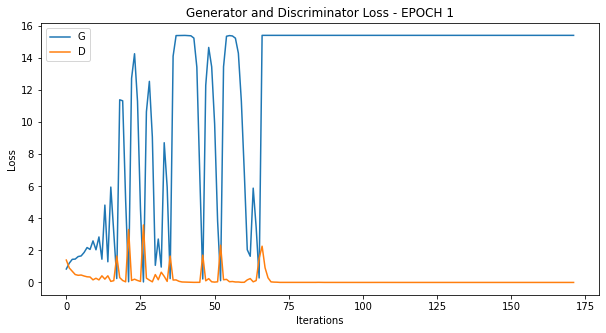

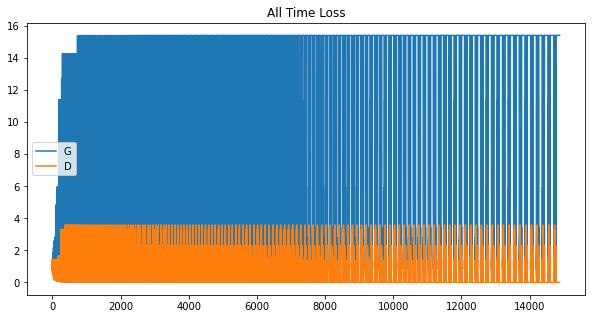

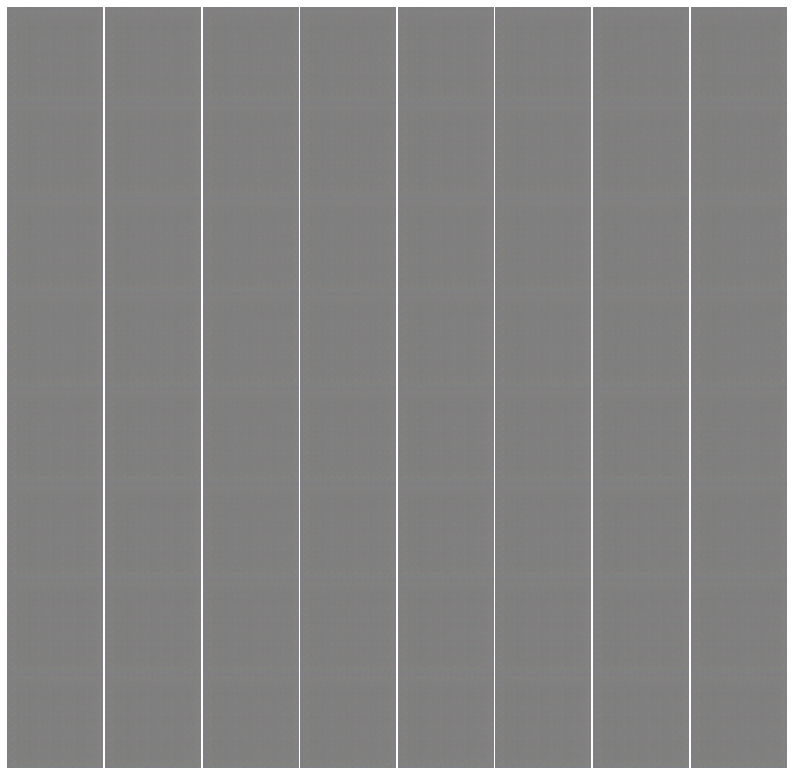

  0%|          | 1/280 [01:22<6:23:11, 82.41s/it]

Epoch: 1 computed for 82.34155702590942 sec
Gen_loss mean:  12.288069  std:  5.358828
Disc_loss mean:  0.18544693  std:  0.51830256


  1%|          | 2/280 [02:41<6:17:41, 81.52s/it]

Epoch: 2 computed for 79.37949872016907 sec
Gen_loss mean:  9.0775585  std:  6.1258945
Disc_loss mean:  0.2711458  std:  0.5492037


  1%|          | 3/280 [04:02<6:14:48, 81.19s/it]

Epoch: 3 computed for 80.36658334732056 sec
Gen_loss mean:  3.1867583  std:  2.1722543
Disc_loss mean:  0.43161777  std:  0.5736261


  1%|▏         | 4/280 [05:23<6:13:00, 81.09s/it]

Epoch: 4 computed for 80.80132913589478 sec
Gen_loss mean:  2.9906368  std:  1.5272301
Disc_loss mean:  0.40669787  std:  0.61679953


  2%|▏         | 5/280 [06:43<6:10:17, 80.79s/it]

Epoch: 5 computed for 80.03657817840576 sec
Gen_loss mean:  3.2245462  std:  2.178159
Disc_loss mean:  0.46331245  std:  0.5082946


  2%|▏         | 6/280 [08:03<6:07:55, 80.57s/it]

Epoch: 6 computed for 79.99443793296814 sec
Gen_loss mean:  2.8454096  std:  1.4641204
Disc_loss mean:  0.4343983  std:  0.2967487


  2%|▎         | 7/280 [09:23<6:06:32, 80.56s/it]

Epoch: 7 computed for 80.4750702381134 sec
Gen_loss mean:  2.587668  std:  1.3674307
Disc_loss mean:  0.52966577  std:  0.3224528


  3%|▎         | 8/280 [10:44<6:05:13, 80.56s/it]

Epoch: 8 computed for 80.52065205574036 sec
Gen_loss mean:  2.3513687  std:  1.1582844
Disc_loss mean:  0.56476814  std:  0.2648529


  3%|▎         | 9/280 [12:04<6:03:27, 80.47s/it]

Epoch: 9 computed for 80.19588470458984 sec
Gen_loss mean:  2.2670326  std:  0.97789717
Disc_loss mean:  0.54302824  std:  0.23532404


  4%|▎         | 10/280 [13:25<6:02:18, 80.51s/it]

Epoch: 10 computed for 80.55911469459534 sec
Gen_loss mean:  2.0414274  std:  1.0489105
Disc_loss mean:  0.701853  std:  0.3922148


  4%|▍         | 11/280 [14:46<6:01:18, 80.59s/it]

Epoch: 11 computed for 80.70263314247131 sec
Gen_loss mean:  2.0325668  std:  1.07154
Disc_loss mean:  0.6897412  std:  0.34557644


  4%|▍         | 12/280 [16:06<5:59:29, 80.48s/it]

Epoch: 12 computed for 80.1876962184906 sec
Gen_loss mean:  2.1849544  std:  1.1166278
Disc_loss mean:  0.65968853  std:  0.26513204


  5%|▍         | 13/280 [17:27<5:58:46, 80.62s/it]

Epoch: 13 computed for 80.8925518989563 sec
Gen_loss mean:  2.1863258  std:  1.2086664
Disc_loss mean:  0.70910287  std:  0.45005253


  5%|▌         | 14/280 [18:47<5:57:24, 80.62s/it]

Epoch: 14 computed for 80.55011343955994 sec
Gen_loss mean:  2.0549166  std:  1.0319787
Disc_loss mean:  0.67652714  std:  0.32725084


  5%|▌         | 15/280 [20:08<5:55:35, 80.51s/it]

Epoch: 15 computed for 80.21002388000488 sec
Gen_loss mean:  2.0675466  std:  1.1905595
Disc_loss mean:  0.7613783  std:  0.41684178


  6%|▌         | 16/280 [21:28<5:54:16, 80.52s/it]

Epoch: 16 computed for 80.47326803207397 sec
Gen_loss mean:  1.8929073  std:  0.84259355
Disc_loss mean:  0.7075177  std:  0.34697375


  6%|▌         | 17/280 [22:48<5:52:19, 80.38s/it]

Epoch: 17 computed for 79.99538111686707 sec
Gen_loss mean:  1.9276457  std:  0.9422896
Disc_loss mean:  0.7612408  std:  0.3712368


  6%|▋         | 18/280 [24:08<5:50:51, 80.35s/it]

Epoch: 18 computed for 80.22759246826172 sec
Gen_loss mean:  1.8060201  std:  0.80324256
Disc_loss mean:  0.74108064  std:  0.33365014


  7%|▋         | 19/280 [25:29<5:49:37, 80.37s/it]

Epoch: 19 computed for 80.36496758460999 sec
Gen_loss mean:  1.919544  std:  0.8998264
Disc_loss mean:  0.7420773  std:  0.30208898


  7%|▋         | 20/280 [26:50<5:49:00, 80.54s/it]

Epoch: 20 computed for 80.87102937698364 sec
Gen_loss mean:  1.8208036  std:  0.79069793
Disc_loss mean:  0.7314075  std:  0.27834743


  8%|▊         | 21/280 [28:11<5:48:11, 80.66s/it]

Epoch: 21 computed for 80.89617252349854 sec
Gen_loss mean:  1.7209544  std:  0.9475748
Disc_loss mean:  0.87155133  std:  0.35139456


  8%|▊         | 22/280 [29:32<5:47:16, 80.76s/it]

Epoch: 22 computed for 80.92734885215759 sec
Gen_loss mean:  1.6746135  std:  0.60334283
Disc_loss mean:  0.7896058  std:  0.2725294


  8%|▊         | 23/280 [30:53<5:46:37, 80.93s/it]

Epoch: 23 computed for 81.25224995613098 sec
Gen_loss mean:  1.7327324  std:  0.8093666
Disc_loss mean:  0.7763663  std:  0.3095463


  9%|▊         | 24/280 [32:15<5:46:23, 81.19s/it]

Epoch: 24 computed for 81.73950242996216 sec
Gen_loss mean:  1.6568182  std:  0.721728
Disc_loss mean:  0.80860525  std:  0.24560194


  9%|▉         | 25/280 [33:36<5:44:49, 81.13s/it]

Epoch: 25 computed for 80.95250058174133 sec
Gen_loss mean:  1.5904098  std:  0.78601867
Disc_loss mean:  0.90034705  std:  0.32245296


  9%|▉         | 26/280 [34:57<5:43:18, 81.10s/it]

Epoch: 26 computed for 80.9478120803833 sec
Gen_loss mean:  1.5690322  std:  0.57034105
Disc_loss mean:  0.80666775  std:  0.21084532


 10%|▉         | 27/280 [36:18<5:41:29, 80.99s/it]

Epoch: 27 computed for 80.6797513961792 sec
Gen_loss mean:  1.5154848  std:  0.7386971
Disc_loss mean:  0.9772134  std:  0.32332268


 10%|█         | 28/280 [37:39<5:40:30, 81.07s/it]

Epoch: 28 computed for 81.21279168128967 sec
Gen_loss mean:  1.458926  std:  0.59727657
Disc_loss mean:  0.8971701  std:  0.23722489


 10%|█         | 29/280 [38:57<5:35:14, 80.14s/it]

Epoch: 29 computed for 77.88994932174683 sec
Gen_loss mean:  1.4368618  std:  0.61122435
Disc_loss mean:  0.9210102  std:  0.2794834


 11%|█         | 30/280 [40:12<5:27:35, 78.62s/it]

Epoch: 30 computed for 75.03039526939392 sec
Gen_loss mean:  1.4336927  std:  0.5805085
Disc_loss mean:  0.9156864  std:  0.22950038


 11%|█         | 31/280 [41:28<5:23:37, 77.98s/it]

Epoch: 31 computed for 76.40520930290222 sec
Gen_loss mean:  1.476085  std:  0.6547256
Disc_loss mean:  0.9097063  std:  0.24388497


 11%|█▏        | 32/280 [42:45<5:20:41, 77.59s/it]

Epoch: 32 computed for 76.59962797164917 sec
Gen_loss mean:  1.5161804  std:  0.6735497
Disc_loss mean:  0.897954  std:  0.3335039


 12%|█▏        | 33/280 [44:01<5:17:15, 77.07s/it]

Epoch: 33 computed for 75.77416586875916 sec
Gen_loss mean:  1.4317986  std:  0.5776471
Disc_loss mean:  0.8897741  std:  0.20544653


 12%|█▏        | 34/280 [45:16<5:13:32, 76.48s/it]

Epoch: 34 computed for 75.02505469322205 sec
Gen_loss mean:  1.4651475  std:  0.63238287
Disc_loss mean:  0.8780638  std:  0.26675624


 12%|█▎        | 35/280 [46:37<5:17:17, 77.71s/it]

Epoch: 35 computed for 80.51879739761353 sec
Gen_loss mean:  1.414268  std:  0.6060421
Disc_loss mean:  0.9310764  std:  0.3506301


 13%|█▎        | 36/280 [47:58<5:20:13, 78.74s/it]

Epoch: 36 computed for 81.10389733314514 sec
Gen_loss mean:  1.4238918  std:  0.5064197
Disc_loss mean:  0.8520955  std:  0.22408383


 13%|█▎        | 37/280 [49:19<5:21:47, 79.45s/it]

Epoch: 37 computed for 81.04978013038635 sec
Gen_loss mean:  1.437564  std:  0.6799321
Disc_loss mean:  0.952775  std:  0.37143195


 14%|█▎        | 38/280 [50:40<5:23:05, 80.11s/it]

Epoch: 38 computed for 81.56970238685608 sec
Gen_loss mean:  1.485668  std:  0.68121445
Disc_loss mean:  0.8867455  std:  0.26493365


 14%|█▍        | 39/280 [52:02<5:23:09, 80.46s/it]

Epoch: 39 computed for 81.21907067298889 sec
Gen_loss mean:  1.5000197  std:  0.63192743
Disc_loss mean:  0.8442296  std:  0.2188074


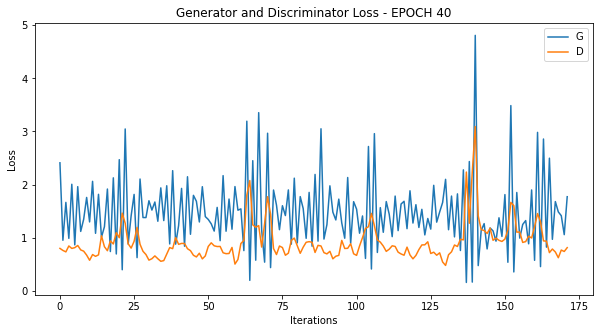

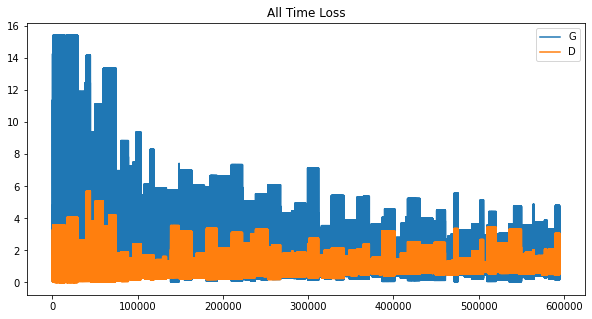

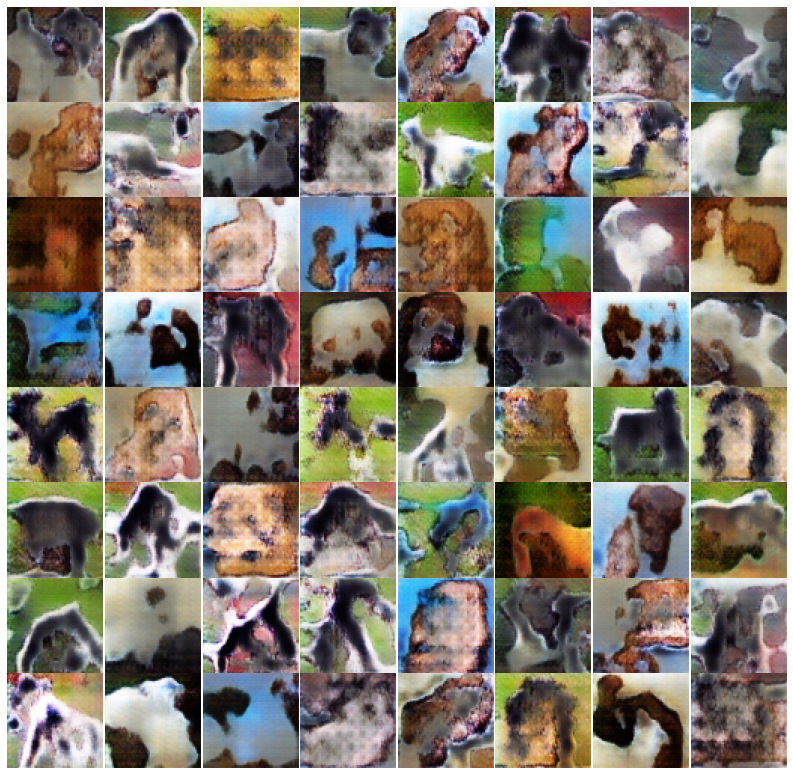

 14%|█▍        | 40/280 [53:26<5:26:30, 81.63s/it]

Epoch: 40 computed for 84.28752112388611 sec
Gen_loss mean:  1.4812973  std:  0.69070596
Disc_loss mean:  0.91389406  std:  0.336487


 15%|█▍        | 41/280 [54:47<5:24:43, 81.52s/it]

Epoch: 41 computed for 81.21531105041504 sec
Gen_loss mean:  1.464093  std:  0.61221313
Disc_loss mean:  0.83733225  std:  0.27643716


 15%|█▌        | 42/280 [56:08<5:22:43, 81.36s/it]

Epoch: 42 computed for 80.92086601257324 sec
Gen_loss mean:  1.4695114  std:  0.7316282
Disc_loss mean:  0.9565401  std:  0.36868554


 15%|█▌        | 43/280 [57:29<5:20:03, 81.03s/it]

Epoch: 43 computed for 80.19560265541077 sec
Gen_loss mean:  1.5770079  std:  0.64315563
Disc_loss mean:  0.80037546  std:  0.22751878


 16%|█▌        | 44/280 [58:49<5:17:57, 80.84s/it]

Epoch: 44 computed for 80.33180093765259 sec
Gen_loss mean:  1.5746877  std:  0.7282167
Disc_loss mean:  0.82911867  std:  0.31702676


 16%|█▌        | 45/280 [1:00:10<5:16:39, 80.85s/it]

Epoch: 45 computed for 80.82452964782715 sec
Gen_loss mean:  1.5296751  std:  0.6237043
Disc_loss mean:  0.817042  std:  0.25314203


 16%|█▋        | 46/280 [1:01:31<5:15:16, 80.84s/it]

Epoch: 46 computed for 80.76393842697144 sec
Gen_loss mean:  1.5262884  std:  0.6004521
Disc_loss mean:  0.78050256  std:  0.26156664


 17%|█▋        | 47/280 [1:02:52<5:13:54, 80.83s/it]

Epoch: 47 computed for 80.7664086818695 sec
Gen_loss mean:  1.5205315  std:  0.72502196
Disc_loss mean:  0.87861854  std:  0.32452554


 17%|█▋        | 48/280 [1:04:12<5:12:08, 80.73s/it]

Epoch: 48 computed for 80.40764570236206 sec
Gen_loss mean:  1.5138321  std:  0.64217436
Disc_loss mean:  0.81409293  std:  0.2009092


 18%|█▊        | 49/280 [1:05:33<5:11:30, 80.91s/it]

Epoch: 49 computed for 81.28253769874573 sec
Gen_loss mean:  1.4668641  std:  0.6300778
Disc_loss mean:  0.87271297  std:  0.39945996


 18%|█▊        | 50/280 [1:06:54<5:09:53, 80.84s/it]

Epoch: 50 computed for 80.63052749633789 sec
Gen_loss mean:  1.481335  std:  0.57683057
Disc_loss mean:  0.8160242  std:  0.26476023


 18%|█▊        | 51/280 [1:08:15<5:08:23, 80.80s/it]

Epoch: 51 computed for 80.63766622543335 sec
Gen_loss mean:  1.4986879  std:  0.68876284
Disc_loss mean:  0.85869294  std:  0.32266432


 19%|█▊        | 52/280 [1:09:36<5:07:02, 80.80s/it]

Epoch: 52 computed for 80.73726654052734 sec
Gen_loss mean:  1.5077263  std:  0.5818909
Disc_loss mean:  0.78242916  std:  0.17524588


 19%|█▉        | 53/280 [1:10:56<5:05:36, 80.78s/it]

Epoch: 53 computed for 80.66952991485596 sec
Gen_loss mean:  1.494746  std:  0.6903657
Disc_loss mean:  0.85605496  std:  0.3069902


 19%|█▉        | 54/280 [1:12:17<5:04:14, 80.77s/it]

Epoch: 54 computed for 80.6868953704834 sec
Gen_loss mean:  1.505117  std:  0.6371664
Disc_loss mean:  0.8211929  std:  0.35018972


 20%|█▉        | 55/280 [1:13:38<5:03:14, 80.86s/it]

Epoch: 55 computed for 81.02491855621338 sec
Gen_loss mean:  1.473812  std:  0.606718
Disc_loss mean:  0.8325628  std:  0.2874726


 20%|██        | 56/280 [1:14:59<5:01:46, 80.83s/it]

Epoch: 56 computed for 80.70348620414734 sec
Gen_loss mean:  1.4906719  std:  0.60516936
Disc_loss mean:  0.81199986  std:  0.23156586


 20%|██        | 57/280 [1:16:20<5:00:22, 80.82s/it]

Epoch: 57 computed for 80.72817468643188 sec
Gen_loss mean:  1.4887106  std:  0.6159917
Disc_loss mean:  0.8174744  std:  0.21359572


 21%|██        | 58/280 [1:17:40<4:58:39, 80.72s/it]

Epoch: 58 computed for 80.42360472679138 sec
Gen_loss mean:  1.4864577  std:  0.60035723
Disc_loss mean:  0.8058564  std:  0.26502207


 21%|██        | 59/280 [1:19:01<4:57:35, 80.79s/it]

Epoch: 59 computed for 80.90247893333435 sec
Gen_loss mean:  1.4631122  std:  0.72484815
Disc_loss mean:  0.8924697  std:  0.46816456


 21%|██▏       | 60/280 [1:20:22<4:56:14, 80.80s/it]

Epoch: 60 computed for 80.74383211135864 sec
Gen_loss mean:  1.4831849  std:  0.56529546
Disc_loss mean:  0.78914005  std:  0.20084916


 22%|██▏       | 61/280 [1:21:42<4:54:41, 80.74s/it]

Epoch: 61 computed for 80.54815626144409 sec
Gen_loss mean:  1.43359  std:  0.5742826
Disc_loss mean:  0.8361482  std:  0.27424392


 22%|██▏       | 62/280 [1:23:04<4:53:57, 80.91s/it]

Epoch: 62 computed for 81.24108958244324 sec
Gen_loss mean:  1.4807756  std:  0.6726699
Disc_loss mean:  0.8523712  std:  0.29977518


 22%|██▎       | 63/280 [1:24:24<4:52:15, 80.81s/it]

Epoch: 63 computed for 80.52690887451172 sec
Gen_loss mean:  1.4551072  std:  0.6318492
Disc_loss mean:  0.85669184  std:  0.33361802


 23%|██▎       | 64/280 [1:25:45<4:50:34, 80.72s/it]

Epoch: 64 computed for 80.43880200386047 sec
Gen_loss mean:  1.4780681  std:  0.5925293
Disc_loss mean:  0.79812527  std:  0.26093817


 23%|██▎       | 65/280 [1:27:06<4:49:50, 80.89s/it]

Epoch: 65 computed for 81.22886800765991 sec
Gen_loss mean:  1.4494117  std:  0.58671343
Disc_loss mean:  0.8310643  std:  0.33718374


 24%|██▎       | 66/280 [1:28:29<4:50:49, 81.54s/it]

Epoch: 66 computed for 83.00910425186157 sec
Gen_loss mean:  1.462115  std:  0.621452
Disc_loss mean:  0.81052375  std:  0.35641328


 24%|██▍       | 67/280 [1:29:50<4:48:39, 81.31s/it]

Epoch: 67 computed for 80.72319889068604 sec
Gen_loss mean:  1.4883994  std:  0.6410401
Disc_loss mean:  0.82249475  std:  0.35850984


 24%|██▍       | 68/280 [1:31:11<4:46:45, 81.16s/it]

Epoch: 68 computed for 80.73961067199707 sec
Gen_loss mean:  1.4939222  std:  0.68454045
Disc_loss mean:  0.8438801  std:  0.34903762


 25%|██▍       | 69/280 [1:32:31<4:44:47, 80.98s/it]

Epoch: 69 computed for 80.52250361442566 sec
Gen_loss mean:  1.4691437  std:  0.5415819
Disc_loss mean:  0.78056353  std:  0.2606416


 25%|██▌       | 70/280 [1:33:53<4:43:49, 81.09s/it]

Epoch: 70 computed for 81.28691911697388 sec
Gen_loss mean:  1.4713532  std:  0.6261061
Disc_loss mean:  0.8443304  std:  0.32034874


 25%|██▌       | 71/280 [1:35:14<4:42:54, 81.22s/it]

Epoch: 71 computed for 81.45214414596558 sec
Gen_loss mean:  1.4429114  std:  0.5926023
Disc_loss mean:  0.8270376  std:  0.33745155


 26%|██▌       | 72/280 [1:36:35<4:41:24, 81.17s/it]

Epoch: 72 computed for 81.01555061340332 sec
Gen_loss mean:  1.4912083  std:  0.5137919
Disc_loss mean:  0.75378513  std:  0.18686068


 26%|██▌       | 73/280 [1:37:56<4:40:00, 81.16s/it]

Epoch: 73 computed for 81.07829475402832 sec
Gen_loss mean:  1.4651283  std:  0.6363906
Disc_loss mean:  0.85346985  std:  0.30438977


 26%|██▋       | 74/280 [1:39:14<4:34:38, 79.99s/it]

Epoch: 74 computed for 77.20187425613403 sec
Gen_loss mean:  1.4811428  std:  0.5792523
Disc_loss mean:  0.7772751  std:  0.1887223


 27%|██▋       | 75/280 [1:40:29<4:28:04, 78.46s/it]

Epoch: 75 computed for 74.81049013137817 sec
Gen_loss mean:  1.4970857  std:  0.5484992
Disc_loss mean:  0.74867976  std:  0.17254503


 27%|██▋       | 76/280 [1:41:45<4:24:56, 77.92s/it]

Epoch: 76 computed for 76.61104106903076 sec
Gen_loss mean:  1.493991  std:  0.64238477
Disc_loss mean:  0.8188011  std:  0.32164067


 28%|██▊       | 77/280 [1:43:01<4:21:43, 77.36s/it]

Epoch: 77 computed for 75.96845245361328 sec
Gen_loss mean:  1.3650393  std:  0.6822845
Disc_loss mean:  0.97060853  std:  0.5335894


 28%|██▊       | 78/280 [1:44:18<4:19:27, 77.07s/it]

Epoch: 78 computed for 76.32063150405884 sec
Gen_loss mean:  1.4619035  std:  0.6957736
Disc_loss mean:  0.9010031  std:  0.45593473


 28%|██▊       | 79/280 [1:45:33<4:16:42, 76.63s/it]

Epoch: 79 computed for 75.53795289993286 sec
Gen_loss mean:  1.4682292  std:  0.5014686
Disc_loss mean:  0.7513651  std:  0.19831185


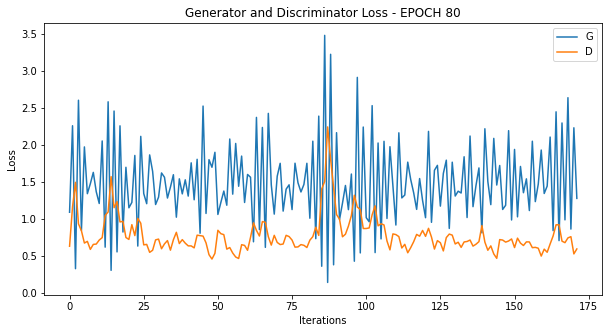

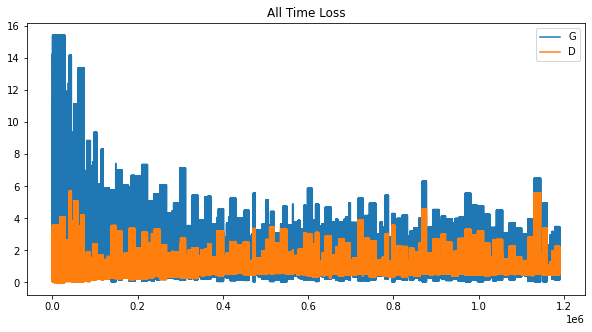

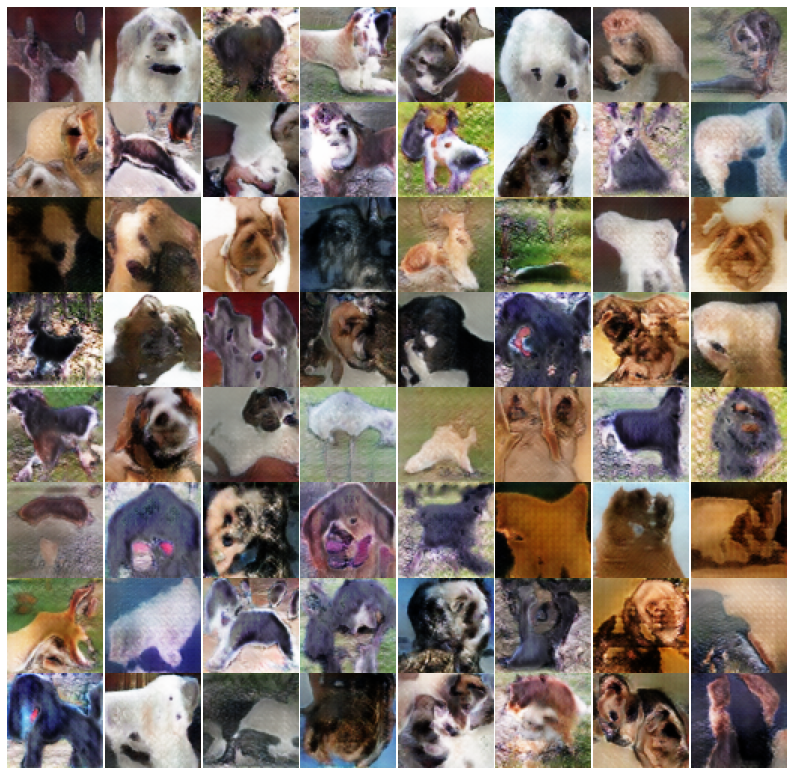

 29%|██▊       | 80/280 [1:46:59<4:24:37, 79.39s/it]

Epoch: 80 computed for 85.76228332519531 sec
Gen_loss mean:  1.4914612  std:  0.57616407
Disc_loss mean:  0.7828529  std:  0.24318038


 29%|██▉       | 81/280 [1:48:21<4:25:22, 80.01s/it]

Epoch: 81 computed for 81.41092872619629 sec
Gen_loss mean:  1.4561383  std:  0.6892445
Disc_loss mean:  0.87133646  std:  0.43618247


 29%|██▉       | 82/280 [1:49:42<4:25:12, 80.37s/it]

Epoch: 82 computed for 81.13946437835693 sec
Gen_loss mean:  1.4683944  std:  0.4859413
Disc_loss mean:  0.7477661  std:  0.19389167


 30%|██▉       | 83/280 [1:51:03<4:24:28, 80.55s/it]

Epoch: 83 computed for 80.92617297172546 sec
Gen_loss mean:  1.4945614  std:  0.61459965
Disc_loss mean:  0.79169923  std:  0.28620264


 30%|███       | 84/280 [1:52:24<4:23:36, 80.70s/it]

Epoch: 84 computed for 80.97912788391113 sec
Gen_loss mean:  1.5224209  std:  0.71761954
Disc_loss mean:  0.78335077  std:  0.30228743


 30%|███       | 85/280 [1:53:45<4:22:22, 80.73s/it]

Epoch: 85 computed for 80.74921536445618 sec
Gen_loss mean:  1.5356777  std:  0.66710234
Disc_loss mean:  0.79788804  std:  0.31570673


 31%|███       | 86/280 [1:55:06<4:21:13, 80.79s/it]

Epoch: 86 computed for 80.87898111343384 sec
Gen_loss mean:  1.4558648  std:  0.5794681
Disc_loss mean:  0.82217085  std:  0.327793


 31%|███       | 87/280 [1:56:27<4:20:03, 80.85s/it]

Epoch: 87 computed for 80.92821168899536 sec
Gen_loss mean:  1.490266  std:  0.57930857
Disc_loss mean:  0.7780211  std:  0.24574488


 31%|███▏      | 88/280 [1:57:47<4:18:28, 80.77s/it]

Epoch: 88 computed for 80.54082465171814 sec
Gen_loss mean:  1.5151066  std:  0.5899992
Disc_loss mean:  0.7526886  std:  0.24775082


 32%|███▏      | 89/280 [1:59:08<4:16:46, 80.66s/it]

Epoch: 89 computed for 80.33956480026245 sec
Gen_loss mean:  1.5322516  std:  0.5902716
Disc_loss mean:  0.7391753  std:  0.1997521


 32%|███▏      | 90/280 [2:00:28<4:15:24, 80.65s/it]

Epoch: 90 computed for 80.5803279876709 sec
Gen_loss mean:  1.5523674  std:  0.7072787
Disc_loss mean:  0.8078798  std:  0.43637392


 32%|███▎      | 91/280 [2:01:49<4:14:12, 80.70s/it]

Epoch: 91 computed for 80.75420689582825 sec
Gen_loss mean:  1.4923936  std:  0.53828186
Disc_loss mean:  0.7380948  std:  0.18989457


 33%|███▎      | 92/280 [2:03:10<4:13:20, 80.85s/it]

Epoch: 92 computed for 81.15909099578857 sec
Gen_loss mean:  1.3448024  std:  0.6810307
Disc_loss mean:  1.0801907  std:  0.6985154


 33%|███▎      | 93/280 [2:04:31<4:11:50, 80.81s/it]

Epoch: 93 computed for 80.6359167098999 sec
Gen_loss mean:  1.4589665  std:  0.46321672
Disc_loss mean:  0.74372506  std:  0.15693624


 34%|███▎      | 94/280 [2:05:53<4:11:56, 81.27s/it]

Epoch: 94 computed for 82.30294847488403 sec
Gen_loss mean:  1.4770107  std:  0.66253936
Disc_loss mean:  0.8783239  std:  0.41059685


 34%|███▍      | 95/280 [2:07:16<4:12:03, 81.75s/it]

Epoch: 95 computed for 82.79363417625427 sec
Gen_loss mean:  1.4922732  std:  0.5257454
Disc_loss mean:  0.73312545  std:  0.2473932


 34%|███▍      | 96/280 [2:08:40<4:12:38, 82.39s/it]

Epoch: 96 computed for 83.81620860099792 sec
Gen_loss mean:  1.526393  std:  0.6375437
Disc_loss mean:  0.7643963  std:  0.25137353


 35%|███▍      | 97/280 [2:10:03<4:12:08, 82.67s/it]

Epoch: 97 computed for 83.26722884178162 sec
Gen_loss mean:  1.5148472  std:  0.49706987
Disc_loss mean:  0.6996338  std:  0.16559395


 35%|███▌      | 98/280 [2:11:27<4:11:20, 82.86s/it]

Epoch: 98 computed for 83.2486674785614 sec
Gen_loss mean:  1.5415337  std:  0.6798277
Disc_loss mean:  0.7765027  std:  0.28321323


 35%|███▌      | 99/280 [2:12:47<4:08:04, 82.23s/it]

Epoch: 99 computed for 80.71134424209595 sec
Gen_loss mean:  1.5324976  std:  0.5580404
Disc_loss mean:  0.7130945  std:  0.1732468
Saved temporary images for evaluation.
Instructions for updating:
Use tf.gfile.GFile.


 36%|███▌      | 100/280 [2:19:04<8:31:58, 170.66s/it]

FID: 97.43095
distance: 1.00000
MiFID: 97.43095
Removed temporary image directory.
Epoch: 100 computed for 376.9300808906555 sec
Gen_loss mean:  1.5005021  std:  0.7346887
Disc_loss mean:  0.8557697  std:  0.5607429


 36%|███▌      | 101/280 [2:20:25<7:08:55, 143.77s/it]

Epoch: 101 computed for 80.98118162155151 sec
Gen_loss mean:  1.5187105  std:  0.59166235
Disc_loss mean:  0.74604994  std:  0.25482252


 36%|███▋      | 102/280 [2:21:46<6:10:20, 124.83s/it]

Epoch: 102 computed for 80.58792161941528 sec
Gen_loss mean:  1.5119706  std:  0.63836086
Disc_loss mean:  0.7985956  std:  0.30927473


 37%|███▋      | 103/280 [2:23:07<5:29:05, 111.56s/it]

Epoch: 103 computed for 80.51412272453308 sec
Gen_loss mean:  1.5348315  std:  0.46735284
Disc_loss mean:  0.66617763  std:  0.15392993


 37%|███▋      | 104/280 [2:24:27<4:59:53, 102.23s/it]

Epoch: 104 computed for 80.42138266563416 sec
Gen_loss mean:  1.5654311  std:  0.6739551
Disc_loss mean:  0.74592483  std:  0.23115209


 38%|███▊      | 105/280 [2:25:48<4:39:08, 95.71s/it] 

Epoch: 105 computed for 80.42239546775818 sec
Gen_loss mean:  1.5386019  std:  0.559247
Disc_loss mean:  0.7162668  std:  0.19356246


 38%|███▊      | 106/280 [2:27:08<4:24:28, 91.20s/it]

Epoch: 106 computed for 80.61503314971924 sec
Gen_loss mean:  1.5260528  std:  0.6634937
Disc_loss mean:  0.8339075  std:  0.5197323


 38%|███▊      | 107/280 [2:28:29<4:14:05, 88.12s/it]

Epoch: 107 computed for 80.89643239974976 sec
Gen_loss mean:  1.3872058  std:  0.5936659
Disc_loss mean:  0.9333559  std:  0.53635526


 39%|███▊      | 108/280 [2:29:50<4:06:43, 86.07s/it]

Epoch: 108 computed for 81.20779228210449 sec
Gen_loss mean:  1.5156907  std:  0.46103406
Disc_loss mean:  0.6776968  std:  0.14164974


 39%|███▉      | 109/280 [2:31:11<4:00:52, 84.52s/it]

Epoch: 109 computed for 80.8555269241333 sec
Gen_loss mean:  1.4993693  std:  0.60963434
Disc_loss mean:  0.7998744  std:  0.38455182


 39%|███▉      | 110/280 [2:32:32<3:56:24, 83.44s/it]

Epoch: 110 computed for 80.85528779029846 sec
Gen_loss mean:  1.4814315  std:  0.6840389
Disc_loss mean:  0.89123684  std:  0.52421904


 40%|███▉      | 111/280 [2:33:53<3:52:49, 82.66s/it]

Epoch: 111 computed for 80.79120469093323 sec
Gen_loss mean:  1.4986532  std:  0.4716052
Disc_loss mean:  0.70092624  std:  0.14210683


 40%|████      | 112/280 [2:35:14<3:50:16, 82.24s/it]

Epoch: 112 computed for 81.20354318618774 sec
Gen_loss mean:  1.4657866  std:  0.6372977
Disc_loss mean:  0.8761015  std:  0.5013838


 40%|████      | 113/280 [2:36:35<3:47:51, 81.87s/it]

Epoch: 113 computed for 80.93251895904541 sec
Gen_loss mean:  1.5170572  std:  0.5797681
Disc_loss mean:  0.7617309  std:  0.41999894


 41%|████      | 114/280 [2:37:56<3:45:51, 81.63s/it]

Epoch: 114 computed for 81.03617906570435 sec
Gen_loss mean:  1.518873  std:  0.53056866
Disc_loss mean:  0.71557635  std:  0.21464501


 41%|████      | 115/280 [2:39:14<3:41:04, 80.39s/it]

Epoch: 115 computed for 77.42068290710449 sec
Gen_loss mean:  1.5420568  std:  0.5962177
Disc_loss mean:  0.7174311  std:  0.182656


 41%|████▏     | 116/280 [2:40:29<3:35:41, 78.91s/it]

Epoch: 116 computed for 75.41034626960754 sec
Gen_loss mean:  1.5502944  std:  0.52801496
Disc_loss mean:  0.6839975  std:  0.1871519


 42%|████▏     | 117/280 [2:41:47<3:33:21, 78.54s/it]

Epoch: 117 computed for 77.58254981040955 sec
Gen_loss mean:  1.5016203  std:  0.68810236
Disc_loss mean:  0.8550753  std:  0.5148658


 42%|████▏     | 118/280 [2:43:04<3:30:47, 78.07s/it]

Epoch: 118 computed for 76.90968036651611 sec
Gen_loss mean:  1.5347389  std:  0.5203093
Disc_loss mean:  0.69826764  std:  0.21095231


 42%|████▎     | 119/280 [2:44:21<3:28:25, 77.67s/it]

Epoch: 119 computed for 76.6661319732666 sec
Gen_loss mean:  1.6628367  std:  0.66290295
Disc_loss mean:  0.65509015  std:  0.23237453


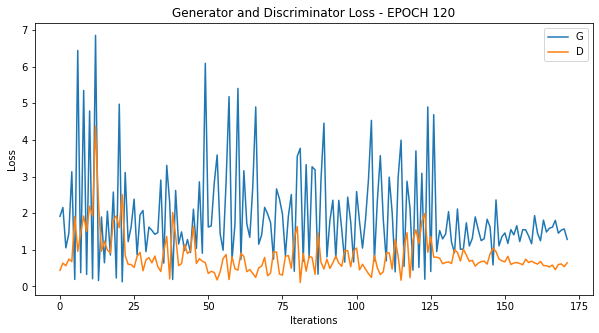

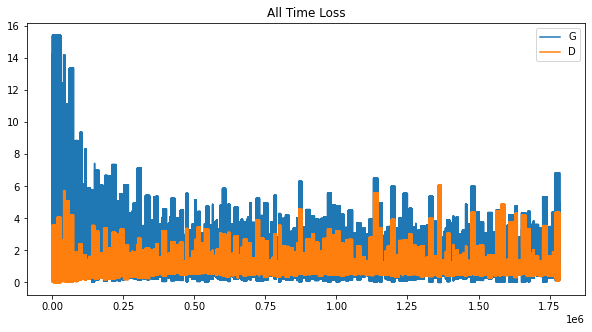

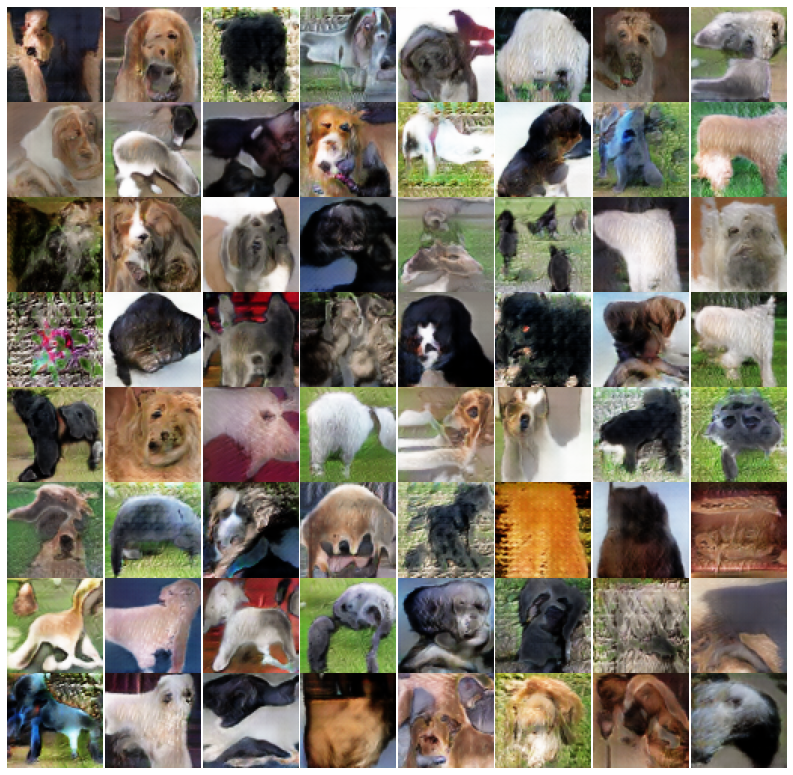

 43%|████▎     | 120/280 [2:45:42<3:30:04, 78.78s/it]

Epoch: 120 computed for 81.3005621433258 sec
Gen_loss mean:  1.9155568  std:  1.2953607
Disc_loss mean:  0.83260804  std:  0.5174427


 43%|████▎     | 121/280 [2:47:06<3:32:32, 80.20s/it]

Epoch: 121 computed for 83.46650910377502 sec
Gen_loss mean:  1.5143646  std:  0.5071424
Disc_loss mean:  0.71191746  std:  0.2604238


 44%|████▎     | 122/280 [2:48:28<3:32:54, 80.85s/it]

Epoch: 122 computed for 82.30023574829102 sec
Gen_loss mean:  1.5381764  std:  0.53870213
Disc_loss mean:  0.70153475  std:  0.24943309


 44%|████▍     | 123/280 [2:49:50<3:32:47, 81.32s/it]

Epoch: 123 computed for 82.36927556991577 sec
Gen_loss mean:  1.515003  std:  0.6408914
Disc_loss mean:  0.7992626  std:  0.5051562


 44%|████▍     | 124/280 [2:51:13<3:32:39, 81.79s/it]

Epoch: 124 computed for 82.82337689399719 sec
Gen_loss mean:  1.5220755  std:  0.55194247
Disc_loss mean:  0.7152485  std:  0.21553892


 45%|████▍     | 125/280 [2:52:36<3:31:52, 82.02s/it]

Epoch: 125 computed for 82.47771787643433 sec
Gen_loss mean:  1.5492183  std:  0.52676415
Disc_loss mean:  0.6733418  std:  0.1340739


 45%|████▌     | 126/280 [2:53:58<3:30:44, 82.11s/it]

Epoch: 126 computed for 82.26011323928833 sec
Gen_loss mean:  1.5637878  std:  0.5798683
Disc_loss mean:  0.69060606  std:  0.15896533


 45%|████▌     | 127/280 [2:55:21<3:29:51, 82.29s/it]

Epoch: 127 computed for 82.66207790374756 sec
Gen_loss mean:  1.1359903  std:  0.74610955
Disc_loss mean:  1.2753179  std:  0.67538875


 46%|████▌     | 128/280 [2:56:44<3:29:02, 82.51s/it]

Epoch: 128 computed for 82.97020840644836 sec
Gen_loss mean:  1.4691381  std:  0.39200035
Disc_loss mean:  0.6856803  std:  0.101636454


 46%|████▌     | 129/280 [2:58:06<3:27:39, 82.51s/it]

Epoch: 129 computed for 82.44360828399658 sec
Gen_loss mean:  1.5306637  std:  0.59105057
Disc_loss mean:  0.73575634  std:  0.25125912


 46%|████▋     | 130/280 [2:59:29<3:26:13, 82.49s/it]

Epoch: 130 computed for 82.3807590007782 sec
Gen_loss mean:  1.438313  std:  0.67494005
Disc_loss mean:  0.94463366  std:  0.6059513


 47%|████▋     | 131/280 [3:00:51<3:24:53, 82.51s/it]

Epoch: 131 computed for 82.4780170917511 sec
Gen_loss mean:  1.4802259  std:  0.39687148
Disc_loss mean:  0.6833749  std:  0.11925836


 47%|████▋     | 132/280 [3:02:14<3:23:26, 82.47s/it]

Epoch: 132 computed for 82.3336250782013 sec
Gen_loss mean:  1.5612576  std:  0.6474468
Disc_loss mean:  0.73604923  std:  0.29423985


 48%|████▊     | 133/280 [3:03:36<3:21:54, 82.41s/it]

Epoch: 133 computed for 82.21285128593445 sec
Gen_loss mean:  1.5409156  std:  0.49770108
Disc_loss mean:  0.67230964  std:  0.16586989


 48%|████▊     | 134/280 [3:04:59<3:20:36, 82.44s/it]

Epoch: 134 computed for 82.46249270439148 sec
Gen_loss mean:  1.4921563  std:  0.6542695
Disc_loss mean:  0.8664044  std:  0.5217104


 48%|████▊     | 135/280 [3:06:22<3:19:37, 82.61s/it]

Epoch: 135 computed for 82.92490482330322 sec
Gen_loss mean:  1.517365  std:  0.6367936
Disc_loss mean:  0.80592453  std:  0.36218044


 49%|████▊     | 136/280 [3:07:44<3:18:01, 82.51s/it]

Epoch: 136 computed for 82.23830652236938 sec
Gen_loss mean:  1.4054911  std:  0.62786955
Disc_loss mean:  0.92258054  std:  0.52056736


 49%|████▉     | 137/280 [3:09:06<3:16:40, 82.52s/it]

Epoch: 137 computed for 82.49016880989075 sec
Gen_loss mean:  1.5164415  std:  0.35642388
Disc_loss mean:  0.63400936  std:  0.076471776


 49%|████▉     | 138/280 [3:10:29<3:15:33, 82.63s/it]

Epoch: 138 computed for 82.82380747795105 sec
Gen_loss mean:  1.5721425  std:  0.57975286
Disc_loss mean:  0.68184566  std:  0.22089761


 50%|████▉     | 139/280 [3:11:52<3:14:03, 82.58s/it]

Epoch: 139 computed for 82.38931655883789 sec
Gen_loss mean:  1.5161728  std:  0.5971074
Disc_loss mean:  0.7901506  std:  0.4013299


 50%|█████     | 140/280 [3:13:14<3:12:43, 82.60s/it]

Epoch: 140 computed for 82.5978901386261 sec
Gen_loss mean:  1.60874  std:  0.50620806
Disc_loss mean:  0.62488663  std:  0.141284


 50%|█████     | 141/280 [3:14:37<3:11:09, 82.51s/it]

Epoch: 141 computed for 82.23906755447388 sec
Gen_loss mean:  1.7831471  std:  1.1278622
Disc_loss mean:  0.89523625  std:  0.6106831


 51%|█████     | 142/280 [3:15:59<3:09:49, 82.53s/it]

Epoch: 142 computed for 82.50820326805115 sec
Gen_loss mean:  1.7094203  std:  0.7590842
Disc_loss mean:  0.6718435  std:  0.29189217


 51%|█████     | 143/280 [3:17:22<3:08:45, 82.67s/it]

Epoch: 143 computed for 82.93333458900452 sec
Gen_loss mean:  1.547526  std:  0.49384308
Disc_loss mean:  0.66394967  std:  0.1431522


 51%|█████▏    | 144/280 [3:18:45<3:07:23, 82.67s/it]

Epoch: 144 computed for 82.6291754245758 sec
Gen_loss mean:  1.5733345  std:  0.5927209
Disc_loss mean:  0.69884264  std:  0.21415174


 52%|█████▏    | 145/280 [3:20:08<3:05:57, 82.65s/it]

Epoch: 145 computed for 82.53555655479431 sec
Gen_loss mean:  1.5715698  std:  0.43890855
Disc_loss mean:  0.6209968  std:  0.09345851


 52%|█████▏    | 146/280 [3:21:30<3:04:28, 82.60s/it]

Epoch: 146 computed for 82.42207026481628 sec
Gen_loss mean:  1.484837  std:  0.6619486
Disc_loss mean:  0.87392986  std:  0.5771953


 52%|█████▎    | 147/280 [3:22:53<3:03:26, 82.75s/it]

Epoch: 147 computed for 83.06003046035767 sec
Gen_loss mean:  1.5429091  std:  0.48775786
Disc_loss mean:  0.67365587  std:  0.22109166


 53%|█████▎    | 148/280 [3:24:16<3:02:13, 82.83s/it]

Epoch: 148 computed for 82.94623804092407 sec
Gen_loss mean:  1.5843396  std:  0.57458866
Disc_loss mean:  0.6644997  std:  0.13766362


 53%|█████▎    | 149/280 [3:25:39<3:00:37, 82.73s/it]

Epoch: 149 computed for 82.42790246009827 sec
Gen_loss mean:  1.5718482  std:  0.50830746
Disc_loss mean:  0.6509379  std:  0.13835669


 54%|█████▎    | 150/280 [3:27:04<3:00:40, 83.39s/it]

Epoch: 150 computed for 84.88973736763 sec
Gen_loss mean:  1.463119  std:  0.7759946
Disc_loss mean:  0.9769191  std:  0.6845169


 54%|█████▍    | 151/280 [3:28:25<2:57:54, 82.75s/it]

Epoch: 151 computed for 81.18577885627747 sec
Gen_loss mean:  1.5438942  std:  0.58193
Disc_loss mean:  0.7380854  std:  0.33006793


 54%|█████▍    | 152/280 [3:29:46<2:55:36, 82.31s/it]

Epoch: 152 computed for 81.24111080169678 sec
Gen_loss mean:  1.5468062  std:  0.5227875
Disc_loss mean:  0.687177  std:  0.21575226


 55%|█████▍    | 153/280 [3:31:08<2:53:42, 82.06s/it]

Epoch: 153 computed for 81.42475175857544 sec
Gen_loss mean:  1.5345658  std:  0.6256754
Disc_loss mean:  0.77628714  std:  0.43599045


 55%|█████▌    | 154/280 [3:32:29<2:52:01, 81.92s/it]

Epoch: 154 computed for 81.51328444480896 sec
Gen_loss mean:  1.5277504  std:  0.5607591
Disc_loss mean:  0.7507428  std:  0.49154058


 55%|█████▌    | 155/280 [3:33:51<2:50:17, 81.74s/it]

Epoch: 155 computed for 81.27377557754517 sec
Gen_loss mean:  1.5447712  std:  0.61912364
Disc_loss mean:  0.7797312  std:  0.46966773


 56%|█████▌    | 156/280 [3:35:12<2:48:36, 81.59s/it]

Epoch: 156 computed for 81.17139840126038 sec
Gen_loss mean:  1.5380242  std:  0.40667516
Disc_loss mean:  0.62787414  std:  0.11984887


 56%|█████▌    | 157/280 [3:36:33<2:47:14, 81.58s/it]

Epoch: 157 computed for 81.51753377914429 sec
Gen_loss mean:  1.5790248  std:  0.5422201
Disc_loss mean:  0.6666539  std:  0.1837


 56%|█████▋    | 158/280 [3:37:55<2:45:55, 81.61s/it]

Epoch: 158 computed for 81.60440635681152 sec
Gen_loss mean:  1.5255084  std:  0.72807056
Disc_loss mean:  0.8763927  std:  0.559702


 57%|█████▋    | 159/280 [3:39:12<2:41:53, 80.28s/it]

Epoch: 159 computed for 77.11678171157837 sec
Gen_loss mean:  1.5504634  std:  0.439427
Disc_loss mean:  0.6347548  std:  0.13725433


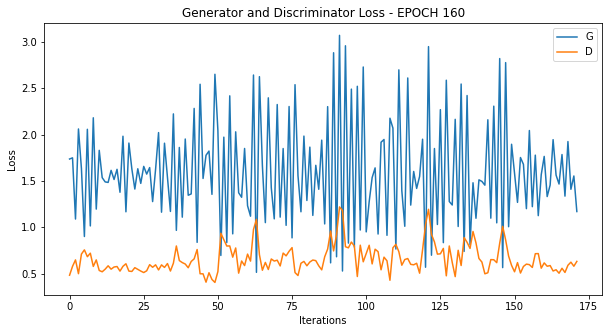

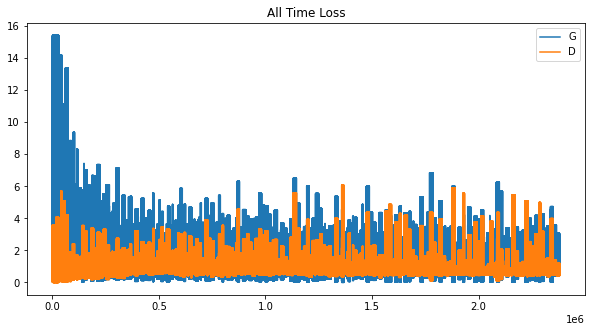

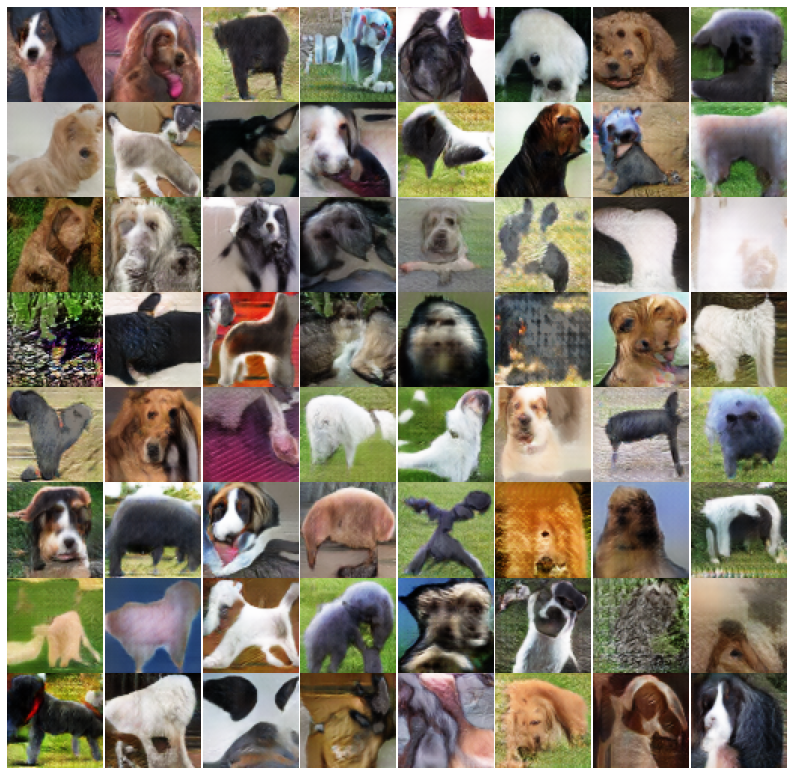

 57%|█████▋    | 160/280 [3:40:33<2:40:48, 80.40s/it]

Epoch: 160 computed for 80.62224102020264 sec
Gen_loss mean:  1.6010356  std:  0.5780121
Disc_loss mean:  0.6572424  std:  0.14754884


 57%|█████▊    | 161/280 [3:41:50<2:37:33, 79.44s/it]

Epoch: 161 computed for 77.12135624885559 sec
Gen_loss mean:  1.5141369  std:  0.66162056
Disc_loss mean:  0.8577842  std:  0.6242732


 58%|█████▊    | 162/280 [3:43:06<2:34:07, 78.37s/it]

Epoch: 162 computed for 75.81394100189209 sec
Gen_loss mean:  1.5626849  std:  0.48249638
Disc_loss mean:  0.6431988  std:  0.13127132


 58%|█████▊    | 163/280 [3:44:22<2:31:24, 77.64s/it]

Epoch: 163 computed for 75.85280466079712 sec
Gen_loss mean:  1.5584902  std:  0.6507819
Disc_loss mean:  0.76979756  std:  0.44156656


 59%|█████▊    | 164/280 [3:45:38<2:29:09, 77.15s/it]

Epoch: 164 computed for 75.94254779815674 sec
Gen_loss mean:  1.7977407  std:  0.82761157
Disc_loss mean:  0.6520836  std:  0.36463213


 59%|█████▉    | 165/280 [3:47:00<2:30:42, 78.63s/it]

Epoch: 165 computed for 82.04060363769531 sec
Gen_loss mean:  1.95329  std:  1.0293058
Disc_loss mean:  0.6340303  std:  0.3160005


 59%|█████▉    | 166/280 [3:48:21<2:31:00, 79.48s/it]

Epoch: 166 computed for 81.40125274658203 sec
Gen_loss mean:  1.5931872  std:  0.41430068
Disc_loss mean:  0.5991865  std:  0.1094158


 60%|█████▉    | 167/280 [3:49:42<2:30:33, 79.94s/it]

Epoch: 167 computed for 80.95524263381958 sec
Gen_loss mean:  1.5563354  std:  0.6240873
Disc_loss mean:  0.77978003  std:  0.49209878


 60%|██████    | 168/280 [3:51:04<2:30:01, 80.37s/it]

Epoch: 168 computed for 81.31242799758911 sec
Gen_loss mean:  1.5764611  std:  0.43837935
Disc_loss mean:  0.6198757  std:  0.13737674


 60%|██████    | 169/280 [3:52:25<2:29:07, 80.61s/it]

Epoch: 169 computed for 81.10567235946655 sec
Gen_loss mean:  1.5762931  std:  0.6421981
Disc_loss mean:  0.7663529  std:  0.47441688


 61%|██████    | 170/280 [3:53:46<2:28:07, 80.80s/it]

Epoch: 170 computed for 81.18032574653625 sec
Gen_loss mean:  1.5886972  std:  0.49037042
Disc_loss mean:  0.62685144  std:  0.11404371


 61%|██████    | 171/280 [3:55:07<2:27:00, 80.92s/it]

Epoch: 171 computed for 81.15676546096802 sec
Gen_loss mean:  1.5935513  std:  0.58961606
Disc_loss mean:  0.703986  std:  0.36194357


 61%|██████▏   | 172/280 [3:56:28<2:25:37, 80.91s/it]

Epoch: 172 computed for 80.81145024299622 sec
Gen_loss mean:  1.4183345  std:  0.6661779
Disc_loss mean:  0.93215203  std:  0.558726


 62%|██████▏   | 173/280 [3:57:49<2:24:21, 80.95s/it]

Epoch: 173 computed for 80.9957799911499 sec
Gen_loss mean:  1.5650656  std:  0.43155923
Disc_loss mean:  0.61840856  std:  0.109203756


 62%|██████▏   | 174/280 [3:59:10<2:23:04, 80.98s/it]

Epoch: 174 computed for 81.00913858413696 sec
Gen_loss mean:  1.597452  std:  0.49286023
Disc_loss mean:  0.62160367  std:  0.13640292


 62%|██████▎   | 175/280 [4:00:31<2:21:43, 80.99s/it]

Epoch: 175 computed for 80.94208693504333 sec
Gen_loss mean:  1.344178  std:  0.656039
Disc_loss mean:  1.0385467  std:  0.7327793


 63%|██████▎   | 176/280 [4:01:53<2:20:34, 81.10s/it]

Epoch: 176 computed for 81.3180844783783 sec
Gen_loss mean:  1.5816191  std:  0.5396803
Disc_loss mean:  0.6500727  std:  0.15007164


 63%|██████▎   | 177/280 [4:03:14<2:19:29, 81.26s/it]

Epoch: 177 computed for 81.56876492500305 sec
Gen_loss mean:  1.6012605  std:  0.49321976
Disc_loss mean:  0.62050253  std:  0.12142988


 64%|██████▎   | 178/280 [4:04:36<2:18:09, 81.27s/it]

Epoch: 178 computed for 81.24343776702881 sec
Gen_loss mean:  1.6223396  std:  0.56116134
Disc_loss mean:  0.6297821  std:  0.127615


 64%|██████▍   | 179/280 [4:05:57<2:16:53, 81.32s/it]

Epoch: 179 computed for 81.37576198577881 sec
Gen_loss mean:  1.5654929  std:  0.659099
Disc_loss mean:  0.7885964  std:  0.43248957


 64%|██████▍   | 180/280 [4:07:18<2:15:30, 81.31s/it]

Epoch: 180 computed for 81.22030735015869 sec
Gen_loss mean:  1.611243  std:  0.6940615
Disc_loss mean:  0.755334  std:  0.5381399


 65%|██████▍   | 181/280 [4:08:39<2:14:00, 81.22s/it]

Epoch: 181 computed for 80.965811252594 sec
Gen_loss mean:  1.5729944  std:  0.45953402
Disc_loss mean:  0.6360008  std:  0.1632786


 65%|██████▌   | 182/280 [4:10:01<2:12:36, 81.19s/it]

Epoch: 182 computed for 81.05655097961426 sec
Gen_loss mean:  1.5280536  std:  0.65567887
Disc_loss mean:  0.848516  std:  0.5238182


 65%|██████▌   | 183/280 [4:11:24<2:12:12, 81.78s/it]

Epoch: 183 computed for 83.10825181007385 sec
Gen_loss mean:  1.6067874  std:  0.41700703
Disc_loss mean:  0.59037036  std:  0.1243567


 66%|██████▌   | 184/280 [4:12:46<2:11:00, 81.88s/it]

Epoch: 184 computed for 82.05491304397583 sec
Gen_loss mean:  1.5661451  std:  0.6744805
Disc_loss mean:  0.81191784  std:  0.51475847


 66%|██████▌   | 185/280 [4:14:07<2:09:19, 81.68s/it]

Epoch: 185 computed for 81.14696979522705 sec
Gen_loss mean:  1.5898982  std:  0.51060563
Disc_loss mean:  0.6680525  std:  0.39221373


 66%|██████▋   | 186/280 [4:15:29<2:07:54, 81.64s/it]

Epoch: 186 computed for 81.49615716934204 sec
Gen_loss mean:  1.9706222  std:  0.8458283
Disc_loss mean:  0.50906974  std:  0.20436639


 67%|██████▋   | 187/280 [4:16:50<2:06:29, 81.61s/it]

Epoch: 187 computed for 81.46597194671631 sec
Gen_loss mean:  1.8490393  std:  0.7471074
Disc_loss mean:  0.5924409  std:  0.47191927


 67%|██████▋   | 188/280 [4:18:12<2:05:07, 81.61s/it]

Epoch: 188 computed for 81.56095314025879 sec
Gen_loss mean:  1.6182244  std:  0.715791
Disc_loss mean:  0.75468993  std:  0.4423806


 68%|██████▊   | 189/280 [4:19:33<2:03:31, 81.45s/it]

Epoch: 189 computed for 81.00623655319214 sec
Gen_loss mean:  1.6305124  std:  0.39771166
Disc_loss mean:  0.56482357  std:  0.087228216


 68%|██████▊   | 190/280 [4:20:54<2:02:04, 81.38s/it]

Epoch: 190 computed for 81.18074560165405 sec
Gen_loss mean:  1.6128757  std:  0.6583039
Disc_loss mean:  0.72502846  std:  0.37110487


 68%|██████▊   | 191/280 [4:22:15<2:00:38, 81.33s/it]

Epoch: 191 computed for 81.15535712242126 sec
Gen_loss mean:  1.6457181  std:  0.5272749
Disc_loss mean:  0.60443485  std:  0.13902318


 69%|██████▊   | 192/280 [4:23:37<1:59:20, 81.37s/it]

Epoch: 192 computed for 81.39406323432922 sec
Gen_loss mean:  1.3135415  std:  0.8118076
Disc_loss mean:  1.0991043  std:  0.7622588


 69%|██████▉   | 193/280 [4:24:58<1:57:58, 81.36s/it]

Epoch: 193 computed for 81.29992961883545 sec
Gen_loss mean:  1.3670545  std:  0.50474477
Disc_loss mean:  0.8615274  std:  0.3457941


 69%|██████▉   | 194/280 [4:26:19<1:56:37, 81.36s/it]

Epoch: 194 computed for 81.28945112228394 sec
Gen_loss mean:  1.5508043  std:  0.62884
Disc_loss mean:  0.77437186  std:  0.45356816


 70%|██████▉   | 195/280 [4:27:41<1:55:23, 81.46s/it]

Epoch: 195 computed for 81.6267602443695 sec
Gen_loss mean:  1.6065735  std:  0.43605947
Disc_loss mean:  0.59417784  std:  0.1261289


 70%|███████   | 196/280 [4:29:03<1:54:01, 81.45s/it]

Epoch: 196 computed for 81.3596785068512 sec
Gen_loss mean:  1.5694534  std:  0.62144005
Disc_loss mean:  0.76970184  std:  0.5543899


 70%|███████   | 197/280 [4:30:24<1:52:37, 81.41s/it]

Epoch: 197 computed for 81.28411507606506 sec
Gen_loss mean:  1.6457498  std:  0.4683066
Disc_loss mean:  0.58081675  std:  0.13716973


 71%|███████   | 198/280 [4:31:45<1:51:12, 81.38s/it]

Epoch: 198 computed for 81.23380923271179 sec
Gen_loss mean:  1.6394645  std:  0.56613934
Disc_loss mean:  0.658407  std:  0.3813447


 71%|███████   | 199/280 [4:33:06<1:49:41, 81.25s/it]

Epoch: 199 computed for 80.90248513221741 sec
Gen_loss mean:  1.1495343  std:  0.6876712
Disc_loss mean:  1.2630855  std:  0.6230966


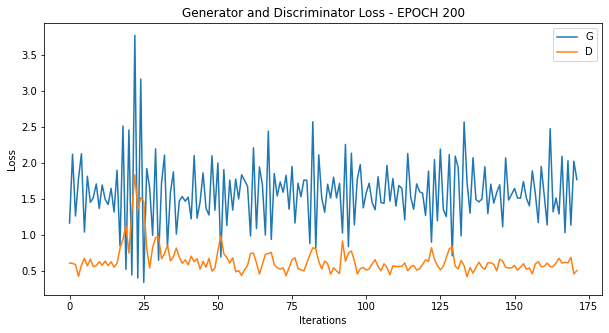

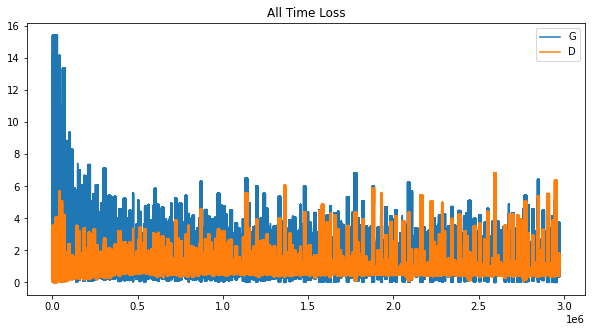

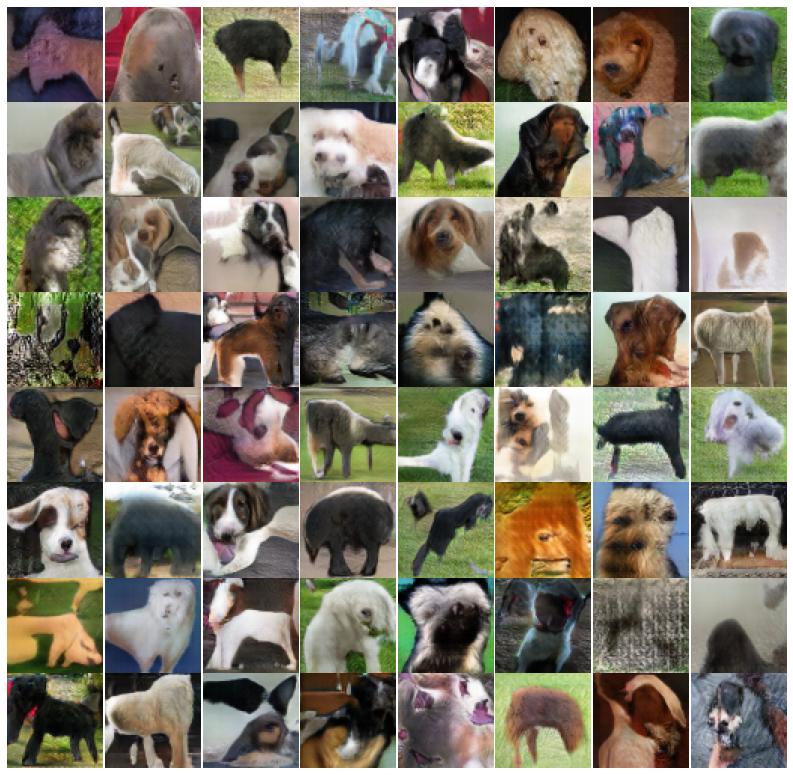

Saved temporary images for evaluation.
FID: 71.41011
distance: 1.00000
MiFID: 71.41011
Removed temporary image directory.
Epoch: 200 computed for 381.2257812023163 sec
Gen_loss mean:  1.5815955  std:  0.47623333


 71%|███████▏  | 200/280 [4:39:27<3:48:21, 171.27s/it]

Disc_loss mean:  0.6393522  std:  0.19114706


 72%|███████▏  | 201/280 [4:40:42<3:07:16, 142.23s/it]

Epoch: 201 computed for 74.40722680091858 sec
Gen_loss mean:  1.6282785  std:  0.5651809
Disc_loss mean:  0.63100314  std:  0.16911334


 72%|███████▏  | 202/280 [4:42:00<2:39:56, 123.03s/it]

Epoch: 202 computed for 78.15740990638733 sec
Gen_loss mean:  1.533355  std:  0.6152257
Disc_loss mean:  0.8073552  std:  0.5646378


 72%|███████▎  | 203/280 [4:43:17<2:20:15, 109.29s/it]

Epoch: 203 computed for 77.15664339065552 sec
Gen_loss mean:  1.6320279  std:  0.60121405
Disc_loss mean:  0.67362535  std:  0.30632758


 73%|███████▎  | 204/280 [4:44:34<2:06:11, 99.62s/it] 

Epoch: 204 computed for 76.99274039268494 sec
Gen_loss mean:  1.6391156  std:  0.44600576
Disc_loss mean:  0.572507  std:  0.106366016


 73%|███████▎  | 205/280 [4:45:52<1:56:08, 92.91s/it]

Epoch: 205 computed for 77.18998193740845 sec
Gen_loss mean:  1.6604117  std:  0.5790861
Disc_loss mean:  0.6126778  std:  0.15695737


 74%|███████▎  | 206/280 [4:47:15<1:50:57, 89.96s/it]

Epoch: 206 computed for 83.03871488571167 sec
Gen_loss mean:  1.6170444  std:  0.598445
Disc_loss mean:  0.7299981  std:  0.524057


 74%|███████▍  | 207/280 [4:48:38<1:47:02, 87.99s/it]

Epoch: 207 computed for 83.31450366973877 sec
Gen_loss mean:  1.6426154  std:  0.61195534
Disc_loss mean:  0.66312313  std:  0.27115977


 74%|███████▍  | 208/280 [4:50:01<1:43:43, 86.44s/it]

Epoch: 208 computed for 82.76582384109497 sec
Gen_loss mean:  1.6413792  std:  0.52320886
Disc_loss mean:  0.6259763  std:  0.28623667


 75%|███████▍  | 209/280 [4:51:24<1:40:58, 85.33s/it]

Epoch: 209 computed for 82.67595982551575 sec
Gen_loss mean:  1.6274214  std:  0.5995144
Disc_loss mean:  0.69184834  std:  0.41689628


 75%|███████▌  | 210/280 [4:52:46<1:38:36, 84.52s/it]

Epoch: 210 computed for 82.56730675697327 sec
Gen_loss mean:  1.6703687  std:  0.5918995
Disc_loss mean:  0.6327779  std:  0.2505326


 75%|███████▌  | 211/280 [4:54:09<1:36:37, 84.02s/it]

Epoch: 211 computed for 82.80441570281982 sec
Gen_loss mean:  1.8535733  std:  0.87002593
Disc_loss mean:  0.61702543  std:  0.47038218


 76%|███████▌  | 212/280 [4:55:32<1:34:38, 83.51s/it]

Epoch: 212 computed for 82.26005506515503 sec
Gen_loss mean:  2.1991165  std:  1.1732662
Disc_loss mean:  0.5277328  std:  0.26880226


 76%|███████▌  | 213/280 [4:56:55<1:33:06, 83.38s/it]

Epoch: 213 computed for 83.03327751159668 sec
Gen_loss mean:  1.694796  std:  0.52839863
Disc_loss mean:  0.58308685  std:  0.16305912


 76%|███████▋  | 214/280 [4:58:18<1:31:41, 83.36s/it]

Epoch: 214 computed for 83.23848962783813 sec
Gen_loss mean:  1.6760213  std:  0.6623938
Disc_loss mean:  0.68839395  std:  0.44652253


 77%|███████▋  | 215/280 [4:59:41<1:30:08, 83.21s/it]

Epoch: 215 computed for 82.80402040481567 sec
Gen_loss mean:  1.6701503  std:  0.4920333
Disc_loss mean:  0.57356685  std:  0.144439


 77%|███████▋  | 216/280 [5:01:04<1:28:50, 83.29s/it]

Epoch: 216 computed for 83.43492412567139 sec
Gen_loss mean:  1.6811824  std:  0.511907
Disc_loss mean:  0.57580954  std:  0.11980233


 78%|███████▊  | 217/280 [5:02:27<1:27:18, 83.15s/it]

Epoch: 217 computed for 82.74837255477905 sec
Gen_loss mean:  1.6517277  std:  0.7283398
Disc_loss mean:  0.750717  std:  0.5325455


 78%|███████▊  | 218/280 [5:03:50<1:25:53, 83.12s/it]

Epoch: 218 computed for 83.01312637329102 sec
Gen_loss mean:  1.6754081  std:  0.47914588
Disc_loss mean:  0.56551886  std:  0.15746649


 78%|███████▊  | 219/280 [5:05:13<1:24:31, 83.14s/it]

Epoch: 219 computed for 83.10619974136353 sec
Gen_loss mean:  1.6821249  std:  0.54683506
Disc_loss mean:  0.62030715  std:  0.28619802


 79%|███████▊  | 220/280 [5:06:35<1:22:47, 82.80s/it]

Epoch: 220 computed for 81.9530577659607 sec
Gen_loss mean:  1.4680995  std:  0.67950386
Disc_loss mean:  0.90568465  std:  0.6120373


 79%|███████▉  | 221/280 [5:07:59<1:21:39, 83.04s/it]

Epoch: 221 computed for 83.56369972229004 sec
Gen_loss mean:  1.6614408  std:  0.47990125
Disc_loss mean:  0.5875842  std:  0.20462734


 79%|███████▉  | 222/280 [5:09:22<1:20:11, 82.96s/it]

Epoch: 222 computed for 82.70764565467834 sec
Gen_loss mean:  1.6953969  std:  0.5341283
Disc_loss mean:  0.5740489  std:  0.16113472


 80%|███████▉  | 223/280 [5:10:43<1:18:22, 82.49s/it]

Epoch: 223 computed for 81.34089732170105 sec
Gen_loss mean:  1.6652429  std:  0.6124596
Disc_loss mean:  0.67978066  std:  0.44659844


 80%|████████  | 224/280 [5:12:04<1:16:40, 82.16s/it]

Epoch: 224 computed for 81.32367515563965 sec
Gen_loss mean:  1.7044454  std:  0.562069
Disc_loss mean:  0.57857215  std:  0.16511537


 80%|████████  | 225/280 [5:13:26<1:15:10, 82.01s/it]

Epoch: 225 computed for 81.61596727371216 sec
Gen_loss mean:  1.6591763  std:  0.7327313
Disc_loss mean:  0.78384775  std:  0.54846936


 81%|████████  | 226/280 [5:14:48<1:13:42, 81.89s/it]

Epoch: 226 computed for 81.54718255996704 sec
Gen_loss mean:  1.6996688  std:  0.3987086
Disc_loss mean:  0.5280115  std:  0.08147056


 81%|████████  | 227/280 [5:16:09<1:12:14, 81.79s/it]

Epoch: 227 computed for 81.49792647361755 sec
Gen_loss mean:  1.6313146  std:  0.62047875
Disc_loss mean:  0.7210039  std:  0.4759307


 81%|████████▏ | 228/280 [5:17:31<1:10:49, 81.72s/it]

Epoch: 228 computed for 81.49025917053223 sec
Gen_loss mean:  1.6857548  std:  0.5433279
Disc_loss mean:  0.5971575  std:  0.22929035


 82%|████████▏ | 229/280 [5:18:52<1:09:25, 81.67s/it]

Epoch: 229 computed for 81.50698685646057 sec
Gen_loss mean:  1.7314297  std:  0.44849873
Disc_loss mean:  0.52403784  std:  0.08709151


 82%|████████▏ | 230/280 [5:20:16<1:08:27, 82.15s/it]

Epoch: 230 computed for 83.19816136360168 sec
Gen_loss mean:  1.3731029  std:  0.8086813
Disc_loss mean:  1.1082735  std:  0.6594485


 82%|████████▎ | 231/280 [5:21:37<1:06:54, 81.93s/it]

Epoch: 231 computed for 81.35999202728271 sec
Gen_loss mean:  1.6322763  std:  0.44775972
Disc_loss mean:  0.59912395  std:  0.172596


 83%|████████▎ | 232/280 [5:22:58<1:05:25, 81.77s/it]

Epoch: 232 computed for 81.35792279243469 sec
Gen_loss mean:  1.7102727  std:  0.5127144
Disc_loss mean:  0.55897826  std:  0.143534


 83%|████████▎ | 233/280 [5:24:20<1:03:54, 81.59s/it]

Epoch: 233 computed for 81.1088593006134 sec
Gen_loss mean:  1.5796766  std:  0.6620568
Disc_loss mean:  0.80674833  std:  0.5833318


 84%|████████▎ | 234/280 [5:25:41<1:02:30, 81.54s/it]

Epoch: 234 computed for 81.37051892280579 sec
Gen_loss mean:  1.6913277  std:  0.5122288
Disc_loss mean:  0.57732767  std:  0.17575082


 84%|████████▍ | 235/280 [5:27:03<1:01:13, 81.63s/it]

Epoch: 235 computed for 81.77895903587341 sec
Gen_loss mean:  1.7128086  std:  0.51306117
Disc_loss mean:  0.557988  std:  0.15097228


 84%|████████▍ | 236/280 [5:28:25<59:55, 81.73s/it]  

Epoch: 236 computed for 81.88574743270874 sec
Gen_loss mean:  1.2913905  std:  0.8860079
Disc_loss mean:  1.1602536  std:  0.7440767


 85%|████████▍ | 237/280 [5:29:46<58:27, 81.56s/it]

Epoch: 237 computed for 81.12867283821106 sec
Gen_loss mean:  1.5254992  std:  0.49461773
Disc_loss mean:  0.71030784  std:  0.27532634


 85%|████████▌ | 238/280 [5:31:08<57:05, 81.56s/it]

Epoch: 238 computed for 81.49912595748901 sec
Gen_loss mean:  1.7376741  std:  0.44192988
Disc_loss mean:  0.5139444  std:  0.095048375


 85%|████████▌ | 239/280 [5:32:29<55:41, 81.50s/it]

Epoch: 239 computed for 81.30963730812073 sec
Gen_loss mean:  2.2017486  std:  1.3413525
Disc_loss mean:  0.6733238  std:  0.6278516


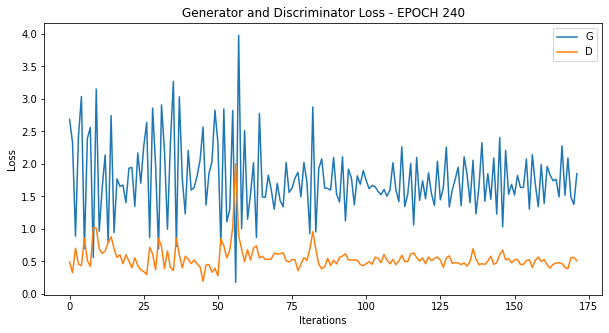

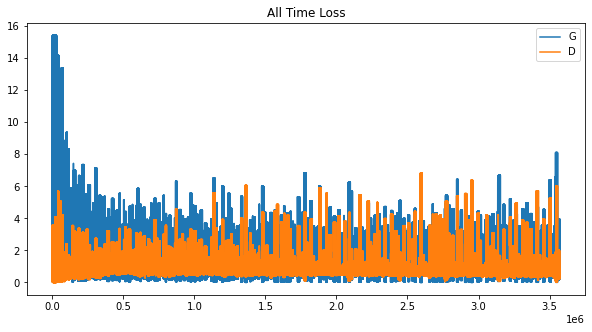

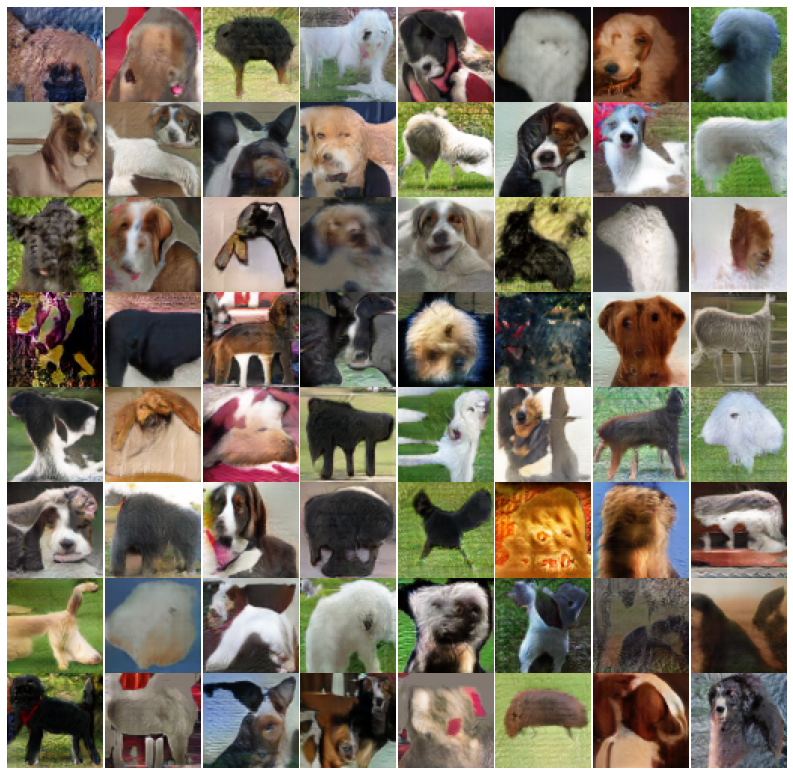

 86%|████████▌ | 240/280 [5:33:55<55:19, 82.99s/it]

Epoch: 240 computed for 86.40482759475708 sec
Gen_loss mean:  1.7619287  std:  0.5648208
Disc_loss mean:  0.548583  std:  0.17501628


 86%|████████▌ | 241/280 [5:35:17<53:35, 82.46s/it]

Epoch: 241 computed for 81.14766311645508 sec
Gen_loss mean:  1.7114556  std:  0.7275392
Disc_loss mean:  0.7098832  std:  0.57515424


 86%|████████▋ | 242/280 [5:36:38<52:04, 82.23s/it]

Epoch: 242 computed for 81.65548348426819 sec
Gen_loss mean:  1.7085546  std:  0.45888844
Disc_loss mean:  0.54429096  std:  0.13002829


 87%|████████▋ | 243/280 [5:38:00<50:36, 82.05s/it]

Epoch: 243 computed for 81.58121061325073 sec
Gen_loss mean:  1.707105  std:  0.5445201
Disc_loss mean:  0.5840984  std:  0.20850101


 87%|████████▋ | 244/280 [5:39:19<48:43, 81.21s/it]

Epoch: 244 computed for 79.17638635635376 sec
Gen_loss mean:  1.734529  std:  0.55322796
Disc_loss mean:  0.5616253  std:  0.18986629


 88%|████████▊ | 245/280 [5:40:37<46:47, 80.21s/it]

Epoch: 245 computed for 77.80725622177124 sec
Gen_loss mean:  1.7259663  std:  0.48978645
Disc_loss mean:  0.53873587  std:  0.11490418


 88%|████████▊ | 246/280 [5:41:59<45:47, 80.82s/it]

Epoch: 246 computed for 82.16977787017822 sec
Gen_loss mean:  1.5810467  std:  0.7725993
Disc_loss mean:  0.84796035  std:  0.661339


 88%|████████▊ | 247/280 [5:43:19<44:15, 80.48s/it]

Epoch: 247 computed for 79.60941648483276 sec
Gen_loss mean:  1.7559861  std:  0.5643966
Disc_loss mean:  0.5494587  std:  0.14234431


 89%|████████▊ | 248/280 [5:44:37<42:33, 79.78s/it]

Epoch: 248 computed for 78.09468936920166 sec
Gen_loss mean:  1.7343888  std:  0.48310164
Disc_loss mean:  0.5319461  std:  0.12017408


 89%|████████▉ | 249/280 [5:45:57<41:12, 79.75s/it]

Epoch: 249 computed for 79.62604594230652 sec
Gen_loss mean:  1.563703  std:  0.6684606
Disc_loss mean:  0.85094947  std:  0.7355283


 89%|████████▉ | 250/280 [5:47:21<40:35, 81.20s/it]

Epoch: 250 computed for 84.49921178817749 sec
Gen_loss mean:  1.5426228  std:  0.6803733
Disc_loss mean:  0.8308365  std:  0.59840703


 90%|████████▉ | 251/280 [5:48:46<39:41, 82.13s/it]

Epoch: 251 computed for 84.24106860160828 sec
Gen_loss mean:  1.7190868  std:  0.45756862
Disc_loss mean:  0.5287052  std:  0.09019592


 90%|█████████ | 252/280 [5:50:10<38:35, 82.70s/it]

Epoch: 252 computed for 83.96372938156128 sec
Gen_loss mean:  1.7605506  std:  0.5513981
Disc_loss mean:  0.54213625  std:  0.13258217


 90%|█████████ | 253/280 [5:51:34<37:24, 83.12s/it]

Epoch: 253 computed for 84.0648763179779 sec
Gen_loss mean:  1.7650228  std:  0.49626914
Disc_loss mean:  0.52040476  std:  0.11493626


 91%|█████████ | 254/280 [5:52:58<36:09, 83.45s/it]

Epoch: 254 computed for 84.13372731208801 sec
Gen_loss mean:  1.7105709  std:  0.6828569
Disc_loss mean:  0.6844315  std:  0.45533705


 91%|█████████ | 255/280 [5:54:22<34:49, 83.59s/it]

Epoch: 255 computed for 83.86677694320679 sec
Gen_loss mean:  1.7675644  std:  0.49286717
Disc_loss mean:  0.5277734  std:  0.1852983


 91%|█████████▏| 256/280 [5:55:46<33:26, 83.62s/it]

Epoch: 256 computed for 83.61127829551697 sec
Gen_loss mean:  1.6685802  std:  0.71125877
Disc_loss mean:  0.7609047  std:  0.6028315


 92%|█████████▏| 257/280 [5:57:10<32:06, 83.75s/it]

Epoch: 257 computed for 84.00586128234863 sec
Gen_loss mean:  1.7206087  std:  0.74210924
Disc_loss mean:  0.70464325  std:  0.56326723


 92%|█████████▏| 258/280 [5:58:34<30:43, 83.81s/it]

Epoch: 258 computed for 83.89527201652527 sec
Gen_loss mean:  1.7542949  std:  0.34373114
Disc_loss mean:  0.49058172  std:  0.08387916


 92%|█████████▎| 259/280 [5:59:57<29:18, 83.75s/it]

Epoch: 259 computed for 83.54694843292236 sec
Gen_loss mean:  1.7625005  std:  0.5733
Disc_loss mean:  0.55071443  std:  0.17597546


 93%|█████████▎| 260/280 [6:01:21<27:56, 83.84s/it]

Epoch: 260 computed for 84.00157570838928 sec
Gen_loss mean:  1.7697346  std:  0.6272898
Disc_loss mean:  0.57915825  std:  0.2500251


 93%|█████████▎| 261/280 [6:02:46<26:35, 83.95s/it]

Epoch: 261 computed for 84.14903593063354 sec
Gen_loss mean:  1.6963562  std:  0.731589
Disc_loss mean:  0.7525044  std:  0.55630314


 94%|█████████▎| 262/280 [6:04:10<25:12, 84.04s/it]

Epoch: 262 computed for 84.19723296165466 sec
Gen_loss mean:  1.7521852  std:  0.53841096
Disc_loss mean:  0.56033057  std:  0.21786784


 94%|█████████▍| 263/280 [6:05:34<23:49, 84.11s/it]

Epoch: 263 computed for 84.19856595993042 sec
Gen_loss mean:  1.6190345  std:  0.69129527
Disc_loss mean:  0.815401  std:  0.6713103


 94%|█████████▍| 264/280 [6:06:57<22:20, 83.78s/it]

Epoch: 264 computed for 82.97107267379761 sec
Gen_loss mean:  1.7476513  std:  0.41516432
Disc_loss mean:  0.51412857  std:  0.102466285


 95%|█████████▍| 265/280 [6:08:20<20:51, 83.42s/it]

Epoch: 265 computed for 82.53235268592834 sec
Gen_loss mean:  1.9746795  std:  0.98978686
Disc_loss mean:  0.6426521  std:  0.4967339


 95%|█████████▌| 266/280 [6:09:43<19:26, 83.29s/it]

Epoch: 266 computed for 82.9280116558075 sec
Gen_loss mean:  2.1397707  std:  0.9433837
Disc_loss mean:  0.4554376  std:  0.19441092


 95%|█████████▌| 267/280 [6:11:05<18:00, 83.11s/it]

Epoch: 267 computed for 82.61724042892456 sec
Gen_loss mean:  1.8107002  std:  0.61857563
Disc_loss mean:  0.5599854  std:  0.36033967


 96%|█████████▌| 268/280 [6:12:28<16:36, 83.04s/it]

Epoch: 268 computed for 82.82318878173828 sec
Gen_loss mean:  1.668739  std:  0.6222788
Disc_loss mean:  0.7090123  std:  0.5917581


 96%|█████████▌| 269/280 [6:13:55<15:24, 84.07s/it]

Epoch: 269 computed for 86.43323183059692 sec
Gen_loss mean:  1.7884891  std:  0.47344255
Disc_loss mean:  0.49971256  std:  0.099816374


 96%|█████████▋| 270/280 [6:15:19<14:01, 84.11s/it]

Epoch: 270 computed for 84.14976334571838 sec
Gen_loss mean:  1.8142372  std:  0.5799721
Disc_loss mean:  0.52171236  std:  0.12667912


 97%|█████████▋| 271/280 [6:16:42<12:33, 83.77s/it]

Epoch: 271 computed for 82.92155718803406 sec
Gen_loss mean:  1.5736454  std:  0.775961
Disc_loss mean:  0.87990594  std:  0.63893145


 97%|█████████▋| 272/280 [6:18:05<11:09, 83.64s/it]

Epoch: 272 computed for 83.2620313167572 sec
Gen_loss mean:  1.7720674  std:  0.5122903
Disc_loss mean:  0.5215394  std:  0.13465244


 98%|█████████▊| 273/280 [6:19:28<09:44, 83.47s/it]

Epoch: 273 computed for 83.02045893669128 sec
Gen_loss mean:  1.6421912  std:  0.6349558
Disc_loss mean:  0.74513084  std:  0.55700856


 98%|█████████▊| 274/280 [6:20:51<08:20, 83.36s/it]

Epoch: 274 computed for 83.049236536026 sec
Gen_loss mean:  1.7752739  std:  0.41039428
Disc_loss mean:  0.4858573  std:  0.08533026


 98%|█████████▊| 275/280 [6:22:14<06:55, 83.10s/it]

Epoch: 275 computed for 82.4389078617096 sec
Gen_loss mean:  1.7714539  std:  0.7199533
Disc_loss mean:  0.6640762  std:  0.42308977


 99%|█████████▊| 276/280 [6:23:37<05:32, 83.12s/it]

Epoch: 276 computed for 83.09767866134644 sec
Gen_loss mean:  1.7919965  std:  0.5019141
Disc_loss mean:  0.51280135  std:  0.1429362


 99%|█████████▉| 277/280 [6:25:00<04:09, 83.07s/it]

Epoch: 277 computed for 82.89295434951782 sec
Gen_loss mean:  1.8343251  std:  0.6397939
Disc_loss mean:  0.58618414  std:  0.5194937


 99%|█████████▉| 278/280 [6:26:23<02:45, 82.98s/it]

Epoch: 278 computed for 82.72963571548462 sec
Gen_loss mean:  1.7618561  std:  0.56392777
Disc_loss mean:  0.56389016  std:  0.19579627


100%|█████████▉| 279/280 [6:27:45<01:22, 82.87s/it]

Epoch: 279 computed for 82.53889322280884 sec
Gen_loss mean:  1.8289759  std:  0.49557614
Disc_loss mean:  0.48037446  std:  0.09853834


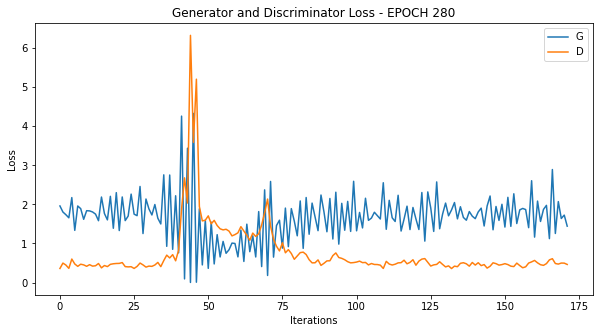

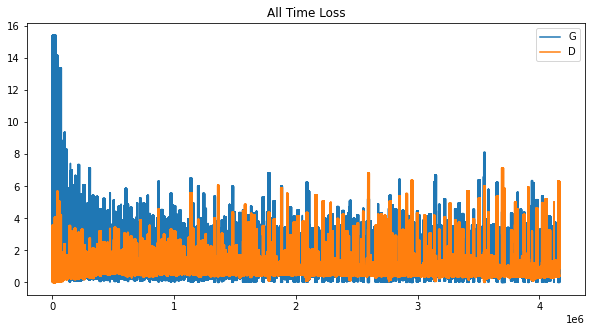

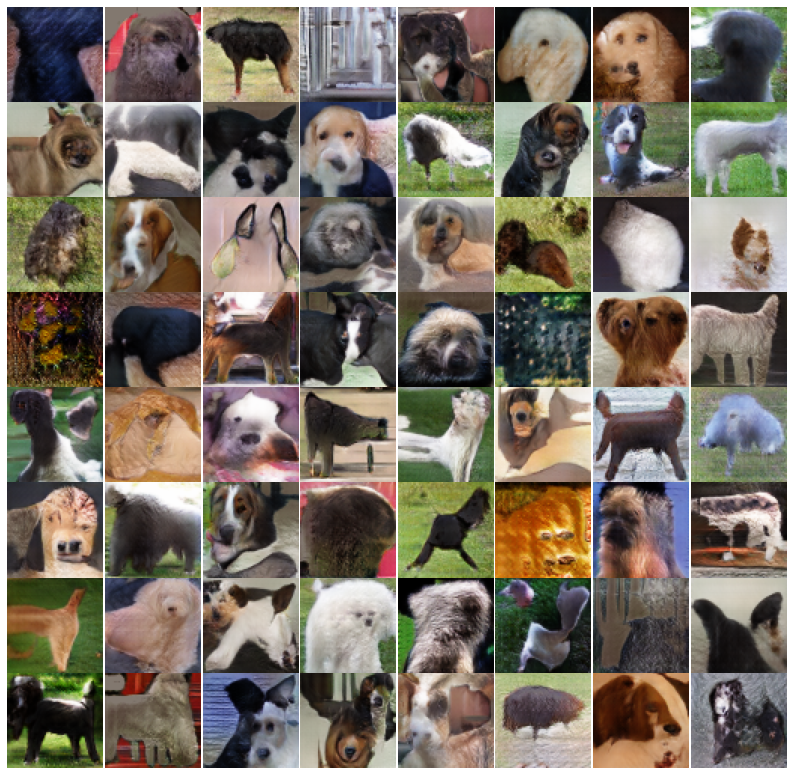

100%|██████████| 280/280 [6:29:14<00:00, 83.41s/it]

Epoch: 280 computed for 88.73181533813477 sec
Gen_loss mean:  1.6567085  std:  0.63545585
Disc_loss mean:  0.75880474  std:  0.719387


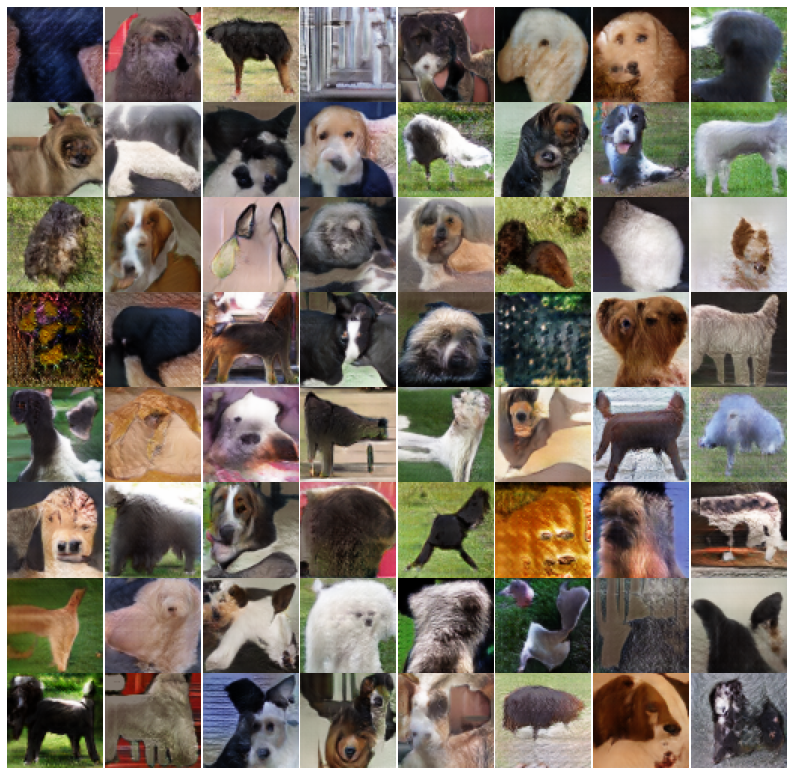

Saved temporary images for evaluation.
FID: 65.17146
distance: 1.00000
MiFID: 65.17146
Removed temporary image directory.
Final epoch.


In [44]:
#%%time
train(dog_features_data, EPOCHS)

&nbsp;&nbsp;&nbsp;As we can observe, the MIFID steadily improves for 260 epochs (~ 8 hours). The best score that I achieved using this model during the competition was <b>55.87</b>. The learning process does tend to be somewhat random so I think a score around the region of <b>[50, 65]</b> should be realistic.

### Generate a test image

&nbsp;&nbsp;&nbsp;We can also reuse one of the previous functions to generate a single random dog image.

In [45]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

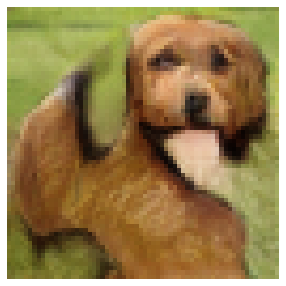

In [63]:
generate_test_image(dog_generator)

### Generate 10000 images for submission and save them to a zip file

In [ ]:
#zip_images()

### Create an animated GIF using the training images

In [54]:
# Display a single image using the epoch number
def display_image(epoch_no):
    return Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

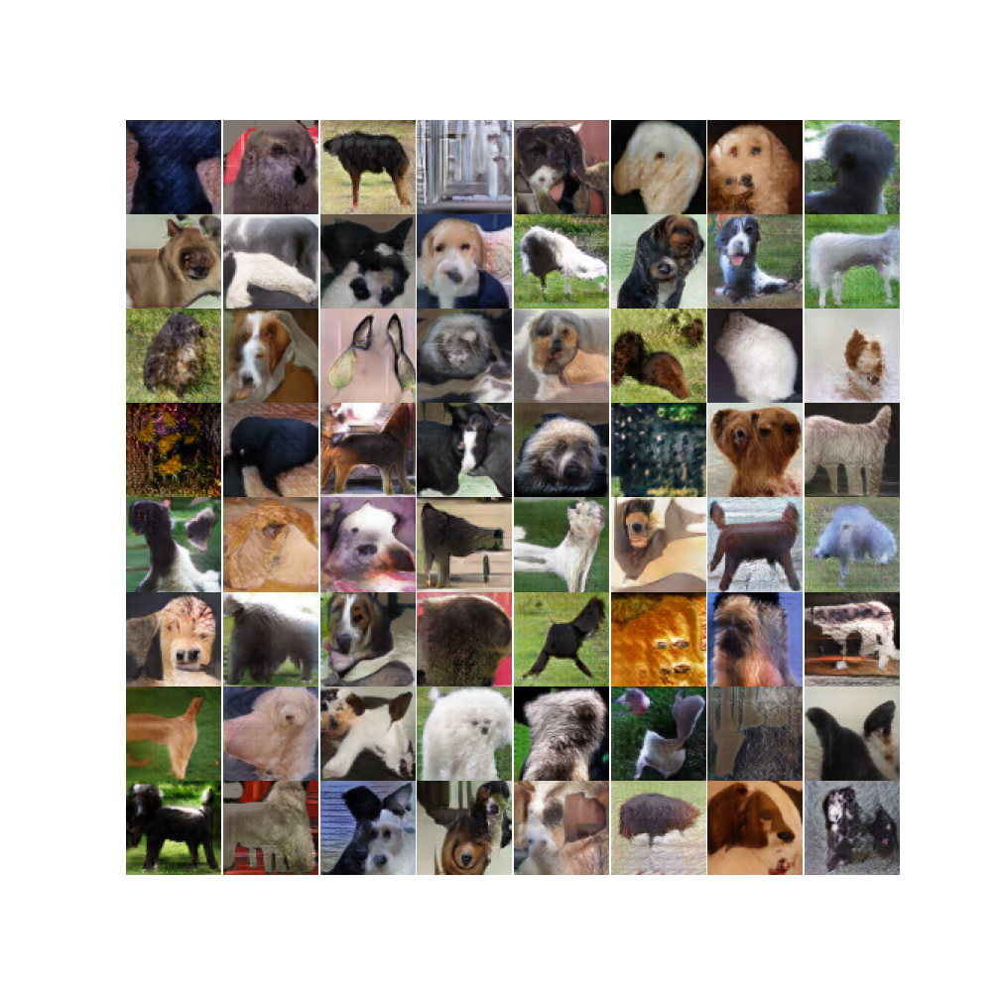

In [55]:
display_image(EPOCHS)

In [56]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    last = -1
    for i,filename in enumerate(filenames):
        frame = 1*(i**2)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

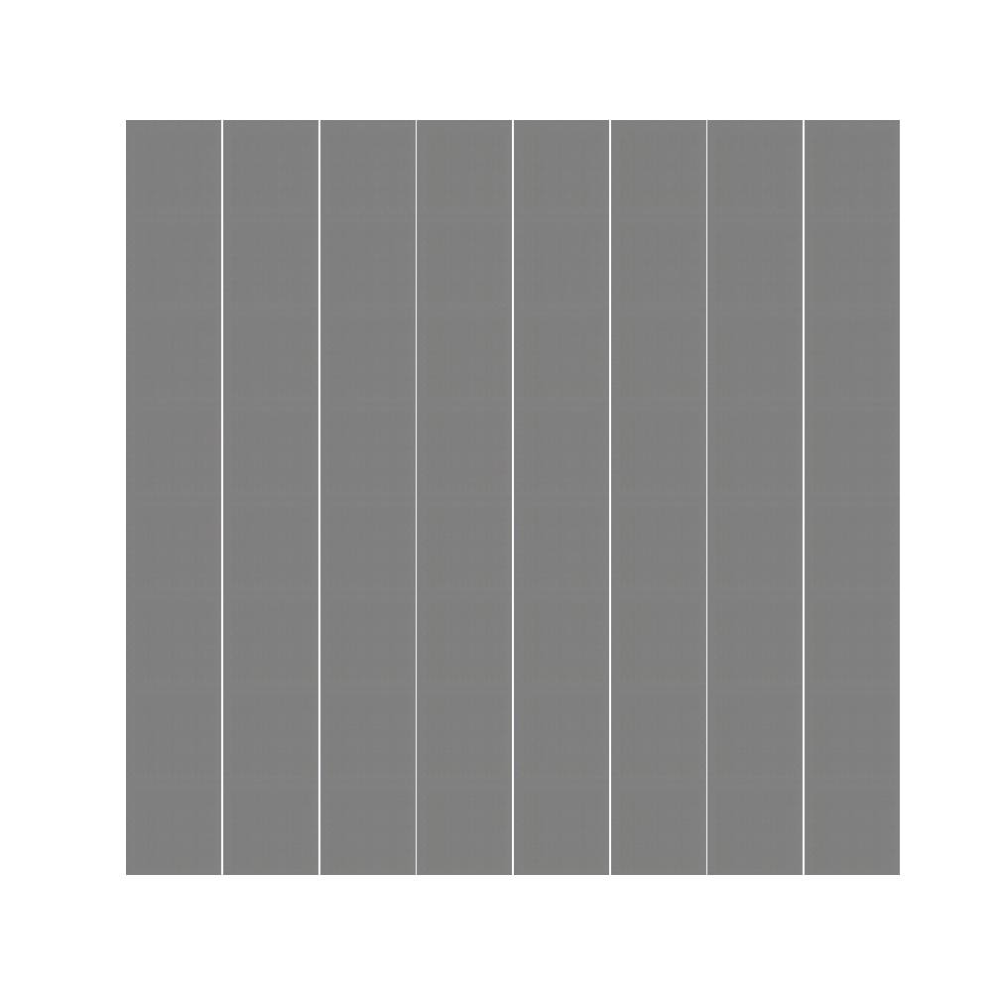

In [57]:
import IPython
IPython.display.Image(filename=anim_file)

## Conclusion

&nbsp;&nbsp;&nbsp;To sum up, <b>DCGANs</b> seem to be extremely sensitive to hyperparameter choice and a lot of problems can arise during training, including <b>Mode Collapse</b>. They are also very computationally intensive and it is incredibly hard to build a high-scoring model for a runtime of <b>~9 hours</b>. Fortunately, there is a whole bucket list of possible methods and techniques that are well-documented and can be easily applied to your model to stabilize the training process.

&nbsp;&nbsp;&nbsp;For me personally, it was really fun to toy around with these techniques and break a few kernels in the process :D. Feel free to leave any suggestions down in the comments (for improving the model or fixing something that I messed up).

&nbsp;&nbsp;&nbsp;If this kernel helped you in any way, feel free to leave an upvote. Also big thanks to <b>Chris Deotte, Nanashi, Chad Malla and Nirjhar Roy</b> for their kernels. I'll leave links to them down below.

## References

### Useful Kernels and notebooks

[1]. My previous kernel on [EDA and image preprocessing](https://www.kaggle.com/jadeblue/dog-generator-starter-eda-preprocessing)

[2]. [Xml parsing and cropping to specified bounding box](https://www.kaggle.com/paulorzp/show-annotations-and-breeds)

[3]. [Image cropping method with interpolation](https://www.kaggle.com/amanooo/wgan-gp-keras)

[4]. [Another great Keras-based DCGAN approach by Chad Malla](https://www.kaggle.com/cmalla94/dcgan-generating-dog-images-with-tensorflow)

[5]. [DCGAN hacks for improving your model performance](https://www.kaggle.com/c/generative-dog-images/discussion/98595)

[6]. [Tensorflow DCGAN tutorial](https://www.tensorflow.org/beta/tutorials/generative/dcgan)

[7]. [DCGAN Dogs Images by Nanashi](https://www.kaggle.com/jesucristo/introducing-dcgan-dogs-images)

[8]. [GAN dogs starter 24-Jul -Custom Layers by Nirjhar Roy](https://www.kaggle.com/phoenix9032/gan-dogs-starter-24-jul-custom-layers)

[9]. [Supervised Generative Dog Net by Chris Deotte](https://www.kaggle.com/cdeotte/supervised-generative-dog-net)

[10]. [My best submission for this competition](https://www.kaggle.com/jadeblue/dogdcgan-v6-ksize)

### Research papers, posts and discussions

[1]. [Generative Adversarial Networks official paper](https://arxiv.org/pdf/1406.2661.pdf)

[2]. [Understanding Generative Adversarial Networks (GANs)](https://towardsdatascience.com/understanding-generative-adversarial-networks-gans-cd6e4651a29)

[3]. [A Gentle Introduction to Generative Adversarial Networks (GANs)](https://machinelearningmastery.com/what-are-generative-adversarial-networks-gans/)

[4]. [DCGAN official paper](https://arxiv.org/pdf/1511.06434.pdf)

[5]. [GAN — DCGAN (Deep convolutional generative adversarial networks)](https://medium.com/@jonathan_hui/gan-dcgan-deep-convolutional-generative-adversarial-networks-df855c438f)

[6]. [Weight Initialization Techniques in Neural Networks](https://towardsdatascience.com/weight-initialization-techniques-in-neural-networks-26c649eb3b78)

[7]. [Spectral Normalization for Generative Adversarial Networks paper](https://arxiv.org/pdf/1802.05957.pdf)

[8]. [Spectral Normalization implemented in Keras](https://github.com/IShengFang/SpectralNormalizationKeras)

[9]. [Spectral Normalization Explained](https://christiancosgrove.com/blog/2018/01/04/spectral-normalization-explained.html)

[10]. [GAN — Ways to improve GAN performance](https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b)

[11]. [How to Implement GAN Hacks in Keras to Train Stable Models](https://machinelearningmastery.com/how-to-code-generative-adversarial-network-hacks/)

[12]. [Tricks of GANS](https://lanpartis.github.io/deep%20learning/2018/03/12/tricks-of-gans.html)

[13]. [Instance Noise: A trick for stabilising GAN training](https://www.inference.vc/instance-noise-a-trick-for-stabilising-gan-training/)

[14]. [GAN — RSGAN & RaGAN (A new generation of cost function.)](https://medium.com/@jonathan_hui/gan-rsgan-ragan-a-new-generation-of-cost-function-84c5374d3c6e)

[15]. [A simple explanation of the Inception Score](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a)

[16]. [GAN — How to measure GAN performance?](https://medium.com/@jonathan_hui/gan-how-to-measure-gan-performance-64b988c47732)

[17]. [All you need is GAN Hacks](https://www.kaggle.com/c/generative-dog-images/discussion/98595#latest-582912)

[18]. [How to train your touchy GANs - Things that seem to work.](https://www.kaggle.com/c/generative-dog-images/discussion/102155#latest-599429)

[19]. [Explaining the metric FID](https://www.kaggle.com/c/generative-dog-images/discussion/97809#latest-591866)